# **Contexto do Desafio**

Neste notebook, realizaremos a Exploratory Data Analysis (EDA) deste projeto, visando extrair insights relevantes solicitados pela C3.
Vamos compreender como diferentes variáveis influenciam o desempenho das ações e quais padrões podem ser extraídos para embasar previsões e escolhas de investimento mais eficazes. Essa iniciativa visa identificar oportunidades ocultas, riscos potenciais e gerar inteligência competitiva baseada em dados.

# **Dicionário da base final**



1. **ID**
  - Tipo: numérico
  - Descrição: identificador único de cada linha do dataset, sendo uma sequência

2. **Date**
  - Tipo: string
  - Descrição: data dos dados da ação naquele dia

3. **Ticker**
  - Tipo: string
  - Descrição: código da empresa negociada na bolsa de valores

4. **Open**
  - Tipo: numérico c
  - Descrição: preço da ação no momento de abertura do mercado no dia especificado em "Date"

5. **High**
  - Tipo: numérico (dólar)
  - Descrição: maior valor que a ação atingiu durante o dia especificado em "Date"

6. **Low**
  - Tipo: numérico (dólar)
  - Descrição: menor valor que a ação atingiu no dia especificado em "Date"

7. **Close**
  - Tipo: numérico (dólar)
  - Descrição: preço da ação no fechamento do mercado no dia especificado em "Date"

8. **Adj Close (Adjusted Close)**
  - Tipo: numérico (dólar)
  - Descrição: preço de fechamento ajustado por eventos como dividendos, desdobramentos (splits), e distribuições, sendo mais apropriado para análise de performance ao longo do tempo

9. **Volume**
  - Tipo: numérico
  - Descrição: quantidade de ações negociadas no dia especificado em "Date"

10. **Dividendo**
  - Tipo: numérico (dólar)
  - Descrição: valor do dividendo pago por ação naquele dia

11. **Split Radio**
  - Tipo: string (essência numérica)
  - Descrição: mostra se houve desdobramento (split) ou agrupamento de ações nesse dia ()






12. **ID**
  - Tipo: numérico
  - Descrição: identificador único de cada linha do dataset, sendo uma sequência

13. **Sector**
  - Tipo: string
  - Descrição: Mostra qual o setor da empresa

14. **Industry**
  - Tipo: string
  - Descrição: Mostra com qual industria a empresa trabalha, sendo uma sub parte de sector

15. **Exchange**
  - Tipo: string
  - Descrição: Bolsa de valores onde ações da empresa são negociadas.

16. **Currency**
  - Tipo: numérico
  - Descrição: Qual o tipo de moeda usada na negociação(USD)

17. **Market Cap**
  - Tipo: numérico
  - Descrição: Valor atual da empresa na bolsa de valores

18. **PE Ratio**
  - Tipo: numérico
  - Descrição: Indica quantos dólares os investidores estão pagando por cada dólar de lucro que a empresa gera

19. **EPS**
  - Tipo: numérico (dólar)
  - Descrição: indica quanto de lucro líquido cada ação da empresa gerou no período analisado, dividindo o lucro pela quantidade de ações compradas

20. **Next Earnings**
  - Tipo: data
  - Descrição: significa o próximo anúncio de resultados (lucros) da empresa

21. **Previous Close**
  - Tipo: numérico (dólar)
  - Descrição: é o último preço pelo qual a ação foi negociada no final do dia anterior

12. **Day Range**
  - Tipo: numérico
  - Descrição: mostra a variação de preço da ação ao longo do dia atual de negociação
    ---






# **EDA**

## **Análises prévias**

-> Nesse tópico, faremos análises prévias da base antes de especificarmos nossas análises com base nos nortes fornecidos e nos nortes que encontraremos naturalmente em nossas análises

---

### **Importação das bibliotecas e da base final**

-> Primeiramente, importaremos as bibliotecas que iremos utilizar para manipulação e análise de dados + criação de gráficos:


- Pandas: para manipulação e análise de dados estruturados em tabelas
- NumPy: para realizar operações matemáticas eficientes
- re: biblioteca para trabalhar com strings
- matplotlib, seaborn e plotly: usadas para criação de gráficos
- google.colab: usada para acessar o google Drive pelo Colab



In [1]:
# Importando as libs que serão utilizadas durante a análise dos dados
import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from google.colab import drive

In [2]:

drive.mount('/content/drive')

Mounted at /content/drive


-> Agora, importaremos a base final tratada e padronizada

In [3]:
# Importando a base de dados base_final
base_final = pd.read_csv('/content/drive/MyDrive/pta/base_final.csv')

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


---
### **Análises iniciais**

-> Primeiro, vamos analisar o tamanho da base final

In [5]:
base_final.shape

(200000, 22)

-> Agora vamos verificar as informações da base

In [6]:
base_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 22 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Unnamed: 0      200000 non-null  int64  
 1   ID              200000 non-null  int64  
 2   Date            200000 non-null  object 
 3   Ticker          200000 non-null  object 
 4   Open            200000 non-null  float64
 5   High            200000 non-null  float64
 6   Low             200000 non-null  float64
 7   Close           200000 non-null  float64
 8   Adj Close       200000 non-null  float64
 9   Volume          200000 non-null  int64  
 10  Dividend        200000 non-null  float64
 11  Split Ratio     200000 non-null  object 
 12  Sector          200000 non-null  object 
 13  Industry        200000 non-null  object 
 14  Exchange        200000 non-null  object 
 15  Currency        200000 non-null  object 
 16  MarketCap       200000 non-null  int64  
 17  PE Ratio  

-> Excluiremos a coluna desnecessária "Unnamed"

In [7]:
base_final = base_final.drop(base_final.columns[0], axis=1)

-> Verificaremos as primeiras linhas para visualização geral

In [8]:
base_final.head(5)

,ID,Date,Ticker,Open,High,Low,Close,Adj Close,Volume,Dividend,...,Sector,Industry,Exchange,Currency,MarketCap,PE Ratio,EPS,Next Earnings,Previous Close,Day Range
0,1,2023-09-03,META,909.63,1380.05,909.63,909.63,61.54,8846040350,3.57,...,Communication,Media & Interactive Services,NYSE,USD,370815220190,27.40,16.68,2025-05-19,567.57,470.42
1,2,2024-08-28,NVDA,678.96,725.03,185.51,295.83,843.78,7346935699,2.85,...,Technology,Semiconductors,TSE,USD,1289775810656,90.13,0.57,2025-06-23,185.12,539.52
2,3,2022-05-10,INTU,831.86,831.86,215.00,831.86,336.19,8027589419,2.28,...,Technology,Software – Application,LSE,USD,97815908000,15.67,18.17,2025-07-21,823.07,616.86
3,4,2017-12-26,NVDA,508.65,1111.85,508.65,511.49,952.63,1939500000,4.51,...,Technology,Semiconductors,HKEX,USD,1658573090566,83.90,-4.82,2025-07-23,179.88,603.20
4,5,2022-01-20,WORK,692.20,692.20,340.75,378.58,1493.44,8984007687,1.93,...,Technology,Software – Application,NASDAQ,USD,315341356874,79.86,5.67,2025-06-08,1004.79,351.45


-> Extrairemos alguns dados estatísticos da base

In [9]:
base_final.describe().round(2)

,ID,Open,High,Low,Close,Adj Close,Volume,Dividend,MarketCap,PE Ratio,EPS,Previous Close,Day Range
count,200000.00,200000.00,200000.00,200000.00,200000.00,200000.00,2.000000e+05,200000.00,2.000000e+05,200000.00,200000.00,200000.00,200000.00
mean,100000.50,774.61,1015.23,532.29,773.48,775.46,4.993364e+09,2.50,8.266702e+11,52.55,7.50,774.69,482.94
std,57735.17,324.39,342.28,341.51,324.27,418.04,2.887239e+09,1.44,6.489181e+11,27.38,7.22,419.67,341.45
min,1.00,51.22,52.28,50.00,50.67,50.00,1.012863e+06,0.00,1.002100e+04,5.00,-5.00,50.00,0.01
25%,50000.75,522.96,772.75,243.00,521.91,413.05,2.490163e+09,1.25,1.814062e+11,28.87,1.26,411.06,193.13
50%,100000.50,773.80,1073.92,473.22,772.34,775.40,4.993552e+09,2.49,7.882040e+11,52.57,7.48,774.30,425.63
75%,150000.25,1027.97,1304.96,772.76,1025.71,1138.19,7.493027e+09,3.75,1.398245e+12,76.23,13.77,1138.67,724.08
max,200000.00,1498.85,1500.00,1498.85,1498.85,1500.00,9.999999e+09,5.00,1.999991e+12,100.00,20.00,1500.00,1447.28


-> Criaremos uma matriz de correlação para termos uma visão geral dos dados correlacionados e tirarmos conclusões

-> Uma matriz de correlação é uma tabela que mostra o grau de relação linear entre diferentes variáveis numéricas, sendo composta por coeficientes de correlação que variam de:

- +1: correlação positiva perfeita (diretamente proporcionais)

- 0: nenhuma correlação linear

- -1: correlação negativa perfeita (inversamente proporcionais)

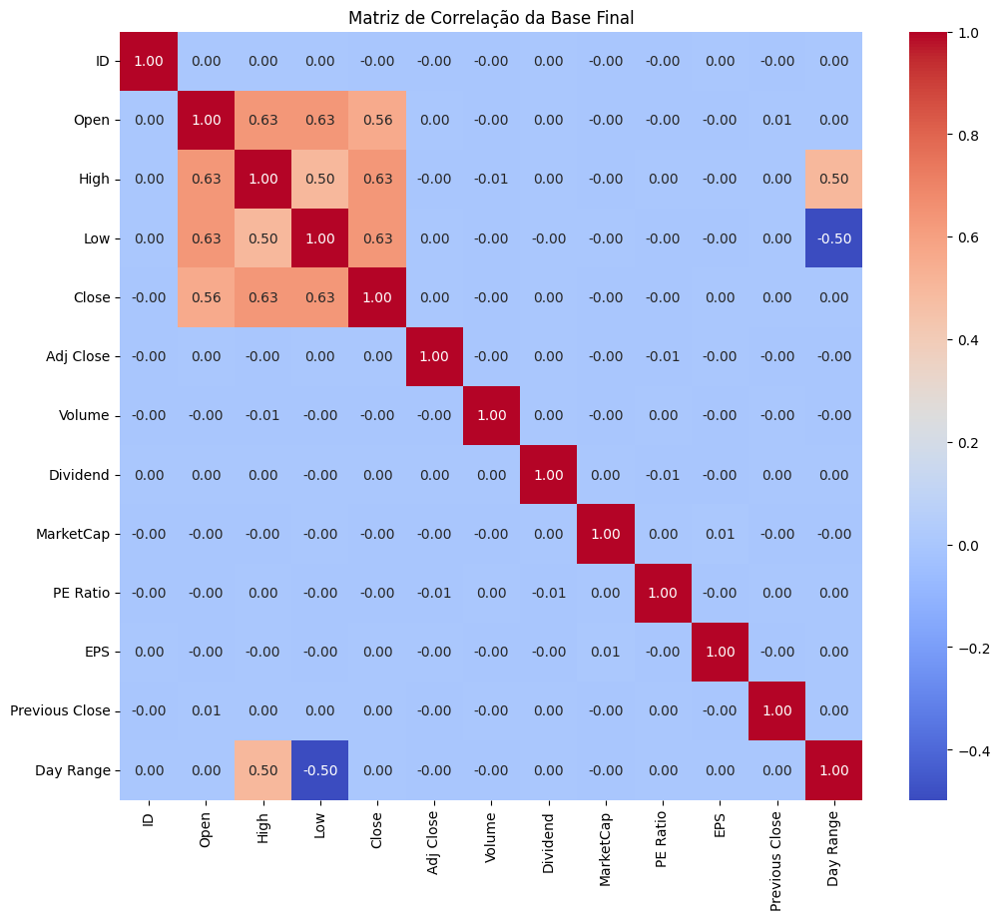

In [10]:
matriz_correlacao = base_final.corr(numeric_only=True)
plt.figure(figsize=(12, 10))
sns.heatmap(matriz_correlacao, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Matriz de Correlação da Base Final')
plt.show()

-> **Conclusões:**

- Alta correlação positiva:

  - High e Low: 0.50: existe uma relação razoável entre os valores máximos e mínimos de um ativo. Isso é esperado, porque ambos fazem parte da variação de preço diária

  - High e Day Range 0.50: correlação positiva moderada, o que é coerente, porque quando o high é mais alto, o range tende a ser maior

  - Day Range e Low -0.50: correlação negativa moderada, o que também é coerente, pois quando o mínimo é mais baixo, o range tende a ser maior
  
  - As variáveis relacionadas aos preços de ações mostraram forte correlação positiva entre si, 0.63, o que é esperado em séries temporais financeiras, pois os preços de opne, high, low e close geralmente se movem em conjunto durante um dia de negociação

- Correlação zero ou quase nula:

    - A maioria das variáveis tem correlação zero entre si, como Volume, MarketCap, PE Ratio, EPS... Isso indica que não há relação linear direta entre essas variáveis no conjunto total analisado

    - ID: como esperávamos, ID tem correlação zero com todas as variáveis, já que é só um identificador



---
## **Análises das perguntas norteadoras**

### **Pergunta 1: Quais são os fatores que mais influenciam o preço de fechamento das ações ao longo do tempo?**

-> Para responder essa pergunta, faremos análises relacionando a o coluna close em relações às outras em função do tempo

---
#### **Análise relação Close x Date**

-> Primeiramente, faremos uma análise da relação Close x Date pna busca por padrões. Faremos um gráfico que demonstra as oscilações do Close ao longo do tempo

In [11]:
# Uso de base auxiliar para análises
aux = base_final.copy()

# Corrigir tipo da coluna 'Close' e 'Date'
aux['Close'] = pd.to_numeric(aux['Close'], errors='coerce')
aux['Date'] = pd.to_datetime(aux['Date'], errors='coerce')

# Remover valores nulos nas colunas relevantes
aux = aux.dropna(subset=['Close', 'Date'])

# Agrupar os preços de fechamento por data (média diária)
aux_grouped = aux.groupby('Date')['Close'].median().reset_index()


import plotly.express as px

fig = px.line(aux_grouped, x='Date', y='Close',
              title='Evolução do preço mediano de fechamento das ações ao longo do tempo')

fig.update_layout(
    xaxis_title='Data',
    yaxis_title='Preço mediano de fechamento (Close)',
    xaxis_rangeslider_visible=True # Add a range slider for better interaction
)

fig.show()

-> **Conclusões:**

-  Notamos que há variações claras ao longo do tempo, sugerindo ciclos de alta e baixa no mercado

-  Como os valores foram agrupados por mediana diária, esse gráfico reflete uma tendência geral do mercado e não de ações específicas
---

-> Concentraremos mais a análise acima para analisar as taxas medianas por ano

In [12]:
aux3 = base_final.copy()

# Converter a coluna de data
aux3['Date'] = pd.to_datetime(aux3['Date'])

aux3['Ano'] = aux3['Date'].dt.year
close_mediano_anual = aux3.groupby('Ano')['Close'].median().reset_index()

# Criar gráfico de linha interativo com Plotly
import plotly.express as px

fig = px.line(
    close_mediano_anual,
    x='Ano',
    y='Close',
    title='Mediana Anual do Preço de Fechamento das Ações',
    markers=True,
    labels={'Close': 'Preço de Fechamento Mediano', 'Ano': 'Ano'},
    template='plotly_white'
)

fig.update_traces(line=dict(width=3), marker=dict(size=8))
fig.update_layout(yaxis_title='Preço Mediano de Fechamento', xaxis_title='Ano')

fig.show()

**Conclusões:**

- Notamos que a mediana do preço de fechamento das ações se mostra de forma cíclica ao longo dos anos, sem uma tendência de alta ou queda sustentada
  - Notamos ciclos de 2 anos em média porque há uma certa alternância entre anos de alta e queda, sugerindo ciclos bianuais de recuperação e correção nos preços mediano

- Forte recuperação e crescimento em 2022–2025, com uma clara tendência de alta. Nesse período de pós pandemia, isso pode indicar recuperação econômica, aumento da confiança do investidor ou valorização de setores estratégicos

**Insights**

- Para investidores, o comportamento da mediana sugere que oscilações são previsíveis e podem ser usadas em estratégias baseadas em ciclos

- Preços de close têm estabilidade relativa, ciclos regulares e rápida recuperação após quedas

---
-> Agora, verificaremos sazonalidades e tendências com análise de séries temporais

<ipython-input-13-36066d990bc0>:18: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



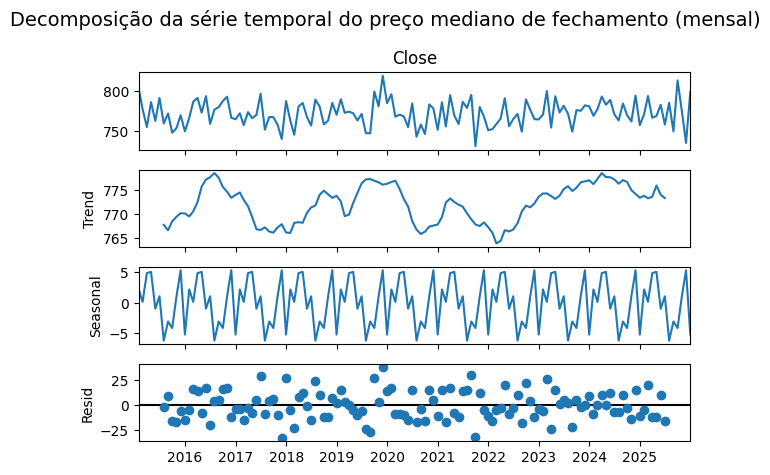

In [13]:
import statsmodels.api as sm

# Carregar dados
aux2 = base_final.copy()

# Conversões
aux2['Close'] = pd.to_numeric(aux2['Close'], errors='coerce')
aux2['Date'] = pd.to_datetime(aux2['Date'], errors='coerce')
aux2 = aux2.dropna(subset=['Close', 'Date'])

# Agrupamento por data e média diária
aux2_grouped = aux2.groupby('Date')['Close'].median().reset_index()

# Usar data como índice
aux2_grouped.set_index('Date', inplace=True)

# Agrupar por mês
monthly_close = aux2_grouped['Close'].resample('M').median()

# Decompor série temporal
decomposition = sm.tsa.seasonal_decompose(monthly_close, model='additive', period=12)

# Plotar componentes
decomposition.plot()
plt.suptitle('Decomposição da série temporal do preço mediano de fechamento (mensal)', fontsize=14)
plt.tight_layout()
plt.show()


1. **Tendência (Trend):**

  - A tendência mostra variações não tão significantes e de longo prazo no preço mediano, com queda gradual em 2018, 2021 e 2022

  - Após certa estabilidade e oscilação entre 2016 e 2021, observa-se uma forte tendência de alta a partir de 2022, melhorando em 2024–2025

  - A partir de 2024, nota-se que o mercado entrou em uma fase de valorização contínua, indicando maior otimismo ou desempenho das ações nesse período

  - **Insight**: pode ser uma janela de oportunidade para investimentos ou indica que fatores macroeconômicos ou setoriais estão impulsionando os preços


2. **Sazonalidade (Seasonal):**

  - A componente sazonal apresenta padrões repetitivos e regulares, vando em ±5 unidades

  - Existem meses específicos do ano que favorecem a valorização ou desvalorização dos preços medianos

  - **Insight**: estratégias de investimento podem se beneficiar do timing sazonal, como compra nos meses com tendência negativa e venda nos meses com tendência positiva; o timing sazonal é útil para a previsão de preços


3. **Resíduos (Residuals):**

  - Os resíduos (ruído ou erro) estão relativamente distribuídos em torno de zero e tem poucos outliers extremos, mas a maioria dos pontos está dentro da faixa de ±25

  - **Insight**: a série de resíduos é bem explicada pela soma da tendência e da sazonalidade com resíduos pequenos e aleatórios, o que indica boa qualidade do modelo de decomposição

4. **Série observada (Close):**

  - Nota-se uma alta volatilidade mensal, oq vai de encontro aos gráficos anteriores, indicando estabilidade com variações cíclicas

  - **Insight**: tem uma tendência de longo prazo bem definida e uma sazonalidade consistente, o que é importante para previsão, além de ter resíduos aleatórios, sugerindo que o comportamento do preço pode ser bem modelado por métodos estatístico

---
-> Seguindo a linha da análise acima, analisaremos agora os meses com maior impacto sazonal

In [14]:
# Recarregar os dados após o reset do ambiente
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.express as px

# Carregar a base de dados
df = base_final.copy()

# Converter a coluna de data
df['Date'] = pd.to_datetime(df['Date'])

# Agrupar por mês e calcular a mediana do preço de fechamento
df_monthly = df.resample('M', on='Date').median(numeric_only=True)

# Decompor a série temporal
decomposition = seasonal_decompose(df_monthly['Close'], model='additive', period=12)

# Obter os valores sazonais
seasonal = decomposition.seasonal

# Criar um DataFrame com os meses e valores sazonais médios
seasonal_df = seasonal.copy()
seasonal_df.index = seasonal_df.index.to_period('M')
seasonal_avg = seasonal_df.groupby(seasonal_df.index.month).median()
seasonal_avg.index.name = 'Mês'
seasonal_avg.name = 'Impacto Sazonal Médio'

# Ordenar do maior para o menor impacto
seasonal_avg_sorted = seasonal_avg.sort_values(ascending=False)


# Preparar os dados para o gráfico
seasonal_plot_df = seasonal_avg_sorted.reset_index()
seasonal_plot_df['Mês'] = seasonal_plot_df['Mês'].apply(lambda x: pd.to_datetime(str(x), format='%m').strftime('%B'))

# Criar gráfico de barras interativo com Plotly
fig = px.bar(
    seasonal_plot_df,
    x='Mês',
    y='Impacto Sazonal Médio',
    title='Impacto Sazonal Médio por Mês no Preço de Fechamento',
    labels={'Impacto Sazonal Médio': 'Impacto Sazonal (em unidades do preço)'},
    text='Impacto Sazonal Médio',
    template='plotly_white'
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(xaxis_title='Mês', yaxis_title='Impacto Sazonal Médio', uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

<ipython-input-14-f2129c2bb189>:12: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusão:**

- Outubro e dezembro são os meses mais historicamente favoráveis para alta nos preços
- Setembro e agosto concentram quedas significativas e podem estar ligados a movimentos típicos do mercado, como rebalanceamento de portfólios ou divulgação de resultados

**Insights:**

- Estratégias de venda ou realização de lucro podem se beneficiar desse comportamento dos meses com preços medianos de fechamento mais altos
- Boas oportunidades de compra com desconto ou preparação para quedas sazonais devem ocorrer nos meses com preços medianos de fechamento mais baixos



---
#### **Análise relação Close x Volume**

-> Analisaremos a correlação close x volume para ver se conseguimos insights

In [15]:
# Recarregar a base de dados
df5 = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
df5['Date'] = pd.to_datetime(df5['Date'])

# Ordenar por data e criar um índice de tempo mensal
df5.sort_values('Date', inplace=True)
df5.set_index('Date', inplace=True)

# Aplicar uma média mensal, selecionando apenas as colunas numéricas relevantes
# Você pode selecionar colunas explicitamente como ['Close', 'Volume']
# ou selecionar todos os tipos numéricos
df_mensal = df5[['Close', 'Volume']].resample('M').median() # Selecionando apenas as colunas 'Close' e 'Volume'

# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
if 'Close' in df_mensal.columns and 'Volume' in df_mensal.columns:
    rolling_corr = df_mensal['Close'].rolling(window=6).corr(df_mensal['Volume'])

    # Plotar a correlação móvel
    import plotly.graph_objects as go

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=rolling_corr.index, y=rolling_corr, mode='lines', name='Correlação Móvel (Close vs Volume)', line=dict(color='seagreen')))

    fig.add_shape(
        type="line",
        x0=rolling_corr.index.min(),
        y0=0,
        x1=rolling_corr.index.max(),
        y1=0,
        line=dict(color="Black", width=1, dash="dash")
    )

    fig.update_layout(
        title='Correlação Móvel entre Close e Volume (Janela de 6 meses)',
        xaxis_title='Ano',
        yaxis_title='Correlação',
        hovermode='x unified'
    )

    fig.show()
else:
    print("Colunas 'Close' ou 'Volume' não encontradas após o resampling.")

<ipython-input-15-1c366fef427d>:14: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusão:**

-  Notamos que o volume não é um preditor consistente do close, porque a correlação muda com o tempo e não se mantém estável. Ou seja, o volume isoladamente não pode ser usado com segurança para prever o comportamento do close
---

---
#### **Análise relação Close x Dividend**

-> Analisaremos a correlação close x dividend para ver se conseguimos insights

In [16]:
# Recarregar a base de dados
df5 = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
df5['Date'] = pd.to_datetime(df5['Date'])

# Ordenar por data e criar um índice de tempo mensal
df5.sort_values('Date', inplace=True)
df5.set_index('Date', inplace=True)

# Aplicar uma média mensal, selecionando apenas as colunas numéricas relevantes
# Você pode selecionar colunas explicitamente como ['Close', 'Volume']
# ou selecionar todos os tipos numéricos
df_mensal = df5[['Close', 'Dividend']].resample('M').median() # Selecionando apenas as colunas 'Close' e 'Volume'

# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
if 'Close' in df_mensal.columns and 'Dividend' in df_mensal.columns:
    rolling_corr = df_mensal['Close'].rolling(window=6).corr(df_mensal['Dividend'])

    # Plotar a correlação móvel
    import plotly.graph_objects as go

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=rolling_corr.index, y=rolling_corr, mode='lines', name='Correlação Móvel (Close vs Dividend)', line=dict(color='seagreen')))

    fig.add_shape(
        type="line",
        x0=rolling_corr.index.min(),
        y0=0,
        x1=rolling_corr.index.max(),
        y1=0,
        line=dict(color="Black", width=1, dash="dash")
    )

    fig.update_layout(
        title='Correlação Móvel entre Close e Dividend (Janela de 6 meses)',
        xaxis_title='Ano',
        yaxis_title='Correlação',
        hovermode='x unified'
    )

    fig.show()
else:
    print("Colunas 'Close' ou 'Volume' não encontradas após o resampling.")

<ipython-input-16-6f3c308d7798>:14: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusão:**

-  Notamos que o dividendo não é um preditor consistente do close, porque a correlação muda com o tempo e não se mantém estável. Ou seja, o dividendo isoladamente não pode ser usado com segurança para prever o comportamento do close
---

---
#### **Análise relação Close x Open**

-> Analisaremos a correlação close x open para ver se conseguimos insights

In [17]:
# Recarregar a base de dados
df5 = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
df5['Date'] = pd.to_datetime(df5['Date'])

# Ordenar por data e criar um índice de tempo mensal
df5.sort_values('Date', inplace=True)
df5.set_index('Date', inplace=True)

# Aplicar uma média mensal, selecionando apenas as colunas numéricas relevantes
# Você pode selecionar colunas explicitamente como ['Close', 'Volume']
# ou selecionar todos os tipos numéricos
df_mensal = df5[['Close', 'Open']].resample('M').median() # Selecionando apenas as colunas 'Close' e 'Volume'

# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
if 'Close' in df_mensal.columns and 'Open' in df_mensal.columns:
    rolling_corr = df_mensal['Close'].rolling(window=6).corr(df_mensal['Open'])

    # Plotar a correlação móvel
    import plotly.graph_objects as go

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=rolling_corr.index, y=rolling_corr, mode='lines', name='Correlação Móvel (Close vs Open)', line=dict(color='seagreen')))

    fig.add_shape(
        type="line",
        x0=rolling_corr.index.min(),
        y0=0,
        x1=rolling_corr.index.max(),
        y1=0,
        line=dict(color="Black", width=1, dash="dash")
    )

    fig.update_layout(
        title='Correlação Móvel entre Close e Open (Janela de 6 meses)',
        xaxis_title='Ano',
        yaxis_title='Correlação',
        hovermode='x unified'
    )

    fig.show()
else:
    print("Colunas 'Close' ou 'Open' não encontradas após o resampling.")

<ipython-input-17-7b9f33e5a9c8>:14: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusões:**

- Notamos que a correlação é geralmente positiva mas volátil, o que indica que, em geral, ações que abrem em certo preço tendem a fechar em um preço próximo

- Notamos também que há períodos de correlação negativa ou instável, indicando que o preço de fechamento não seguiu a mesma direção do preço de abertura e que possivelmente ocorreram eventos externos, notícias de mercado, crises ou aumentos de volatilidade que mudaram a dinâmica de abertura e fechamento

**Insights:**

- Para investidores de curto praze, a alta correlação entre Open e Close pode permitir estratégias mais previsíveis, sabendo-se também que períodos de baixa correlação sugerem cautela



---
#### **Análise relação Close x Low**

-> Analisaremos a correlação close x low para ver se conseguimos insights

In [18]:
# Recarregar a base de dados
df5 = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
df5['Date'] = pd.to_datetime(df5['Date'])

# Ordenar por data e criar um índice de tempo mensal
df5.sort_values('Date', inplace=True)
df5.set_index('Date', inplace=True)

# Aplicar uma média mensal, selecionando apenas as colunas numéricas relevantes
# Você pode selecionar colunas explicitamente como ['Close', 'Volume']
# ou selecionar todos os tipos numéricos
df_mensal = df5[['Close', 'Low']].resample('M').median() # Selecionando apenas as colunas 'Close' e 'Volume'

# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
if 'Close' in df_mensal.columns and 'Low' in df_mensal.columns:
    rolling_corr = df_mensal['Close'].rolling(window=6).corr(df_mensal['Low'])

    # Plotar a correlação móvel
    import plotly.graph_objects as go

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=rolling_corr.index, y=rolling_corr, mode='lines', name='Correlação Móvel (Close vs Low)', line=dict(color='seagreen')))

    fig.add_shape(
        type="line",
        x0=rolling_corr.index.min(),
        y0=0,
        x1=rolling_corr.index.max(),
        y1=0,
        line=dict(color="Black", width=1, dash="dash")
    )

    fig.update_layout(
        title='Correlação Móvel entre Close e Low (Janela de 6 meses)',
        xaxis_title='Ano',
        yaxis_title='Correlação',
        hovermode='x unified'
    )

    fig.show()
else:
    print("Colunas 'Close' ou 'Open' não encontradas após o resampling.")

<ipython-input-18-eb277c53c4c5>:14: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusões:**

- Notamos que a correlação é normalmente alta e positiva, o que indica que o preço de fechamento tende a estar fortemente ligado ao preço mínimo do dia. Ou seja, quando o Low é baixo, o Close geralmente também é

- Notamos também que alguns há períodos específicos com correlação próxima de zero ou até negativa, nos quais o preço de fechamento não acompanhou o preço mínimo. Isso pode indicar:

  - Volatilidade intradiária alta (ações fecharam longe das mínimas do dia)

  - Mudança de comportamento do mercado, talvez devido a incertezas ou choques externos

- Notamos que após esse período de queda, a correlação tende a se recuperar rapidamente, o que indica que esses momentos de baixa sejam anomalias temporárias, não refletindo uma mudança estrutural duradoura

**Insights:**

- Em mercados mais previsíveis (alta correlação), pode ser vantajoso explorar estratégias baseadas em suportes

- Quando a correlação quebra, o mercado pode estar reagindo a fatores imprevisíveis, o que sugere cautela nos investimentos

---
#### **Análise relação Close x High**

-> Analisaremos a correlação close x high para ver se conseguimos insights

In [19]:
# Recarregar a base de dados
df5 = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
df5['Date'] = pd.to_datetime(df5['Date'])

# Ordenar por data e criar um índice de tempo mensal
df5.sort_values('Date', inplace=True)
df5.set_index('Date', inplace=True)

# Aplicar uma média mensal, selecionando apenas as colunas numéricas relevantes
# Você pode selecionar colunas explicitamente como ['Close', 'Volume']
# ou selecionar todos os tipos numéricos
df_mensal = df5[['Close', 'High']].resample('M').median() # Selecionando apenas as colunas 'Close' e 'Volume'

# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
# Calcular correlação móvel entre 'Close' e 'Volume' (janela de 6 meses)
# Certifique-se de que ambas as colunas existem em df_mensal após o resample
if 'Close' in df_mensal.columns and 'High' in df_mensal.columns:
    rolling_corr = df_mensal['Close'].rolling(window=6).corr(df_mensal['High'])

    # Plotar a correlação móvel
    import plotly.graph_objects as go

    fig = go.Figure()

    fig.add_trace(go.Scatter(x=rolling_corr.index, y=rolling_corr, mode='lines', name='Correlação Móvel (Close vs High)', line=dict(color='seagreen')))

    fig.add_shape(
        type="line",
        x0=rolling_corr.index.min(),
        y0=0,
        x1=rolling_corr.index.max(),
        y1=0,
        line=dict(color="Black", width=1, dash="dash")
    )

    fig.update_layout(
        title='Correlação Móvel entre Close e High (Janela de 6 meses)',
        xaxis_title='Ano',
        yaxis_title='Correlação',
        hovermode='x unified'
    )

    fig.show()
else:
    print("Colunas 'Close' ou 'High' não encontradas após o resampling.")

<ipython-input-19-35dc9f0f0deb>:14: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



**Conclusões:**

- Notamos que geralmente Close e High tenham correlação positiva (faz sentido, pois o fechamento costuma estar próximo da máxima do dia e isso indica confiança do mercado e menos volatilidade intradiária), mas o gráfico mostra que essa correlação varia bastante no tempo, inclusive com períodos de correlação negativa

- A oscilação cíclica da correlação pode estar relacionada a ciclos econômicos ou eventos do mercado
  - Alta correlação pode sinalizar estabilidade ou recuperação
  - Baixa correlação ou negatividade pode indicar instabilidade ou tensão no mercado


**Insights:**

- Geralmente menos volatilidade intradiária
- Evitar estratégias que presumem estabilidade no comportamento dos preços
- Volatilidade ou reversão nos momentos de quedas



---
#### **Análise relação Close x Sector / industry / Exchange**

##### **Função de plotagem bastante usada**

In [20]:
def plota_pordata(dataframe, coluna, alvo='Close', altura =350, largura =1000, y_raange=[700, 810], tipo = 'year'):
    # Converter a coluna de data
    dataframe['Date'] = pd.to_datetime(dataframe['Date'])
    if tipo == 'year':
        dataframe['Date'] = dataframe['Date'].dt.year
    else:
        dataframe['Date'] = dataframe['Date'].dt.month

    df_medias_mensais = dataframe.groupby([coluna, 'Date'])[alvo].median().reset_index()

    colunas_unicos = dataframe[coluna].unique()

    for colunas in colunas_unicos:
            df_setor_media = df_medias_mensais[df_medias_mensais[coluna] == colunas]

            if df_setor_media.empty:
                print(f"Não há dados de médias mensais para o '{coluna}' '{colunas}'. Pulando a plotagem.")
                continue

            fig = px.line(
                df_setor_media,
                x='Date',
                y=alvo,
                title=f'Mediana de Fechamento para o {coluna}: {colunas}',
                markers=True,
                labels={'Date': 'Ano', alvo: 'Preço de Fechamento Médio'},
                template='plotly_white'
            )

            # Ajustes visuais
            fig.update_traces(line=dict(width=2, color = 'seagreen'), marker=dict(size=6, symbol='circle'))
            fig.update_layout(
                width=largura,
                height=altura,
                yaxis_title='Preço Médio de Fechamento',
                xaxis_title='Ano',
                hovermode="x unified",
                yaxis_range=y_raange
            )
            fig.update_xaxes(dtick="M1", tickformat="%Y-%m")

            fig.show()

---
##### **Sector**
-> Primeiramente para fazer essa analise precisamos ver quais nomes se encontram em Sector

In [21]:
base_final['Sector'].value_counts()

,count
Sector,
Technology,120230
Communication,46644
Consumer Cyclical,20018
Services,13108


-> Com isso podemos agora ter uma noção do que estamos mechendo.
Com isso vamos tirar algumas metricas para poder extrair alguns dados de Sector x Close

In [22]:
aux_sector = base_final.copy() # copia da base

-> Tirando a mediana dos close por setores podemos perceber que não se tem uma grande diferença, apenas 11 do menor para o maior, o que pode indicar uma estabilidade do mercado, vamos analizar mais a fundo

In [23]:
media_sec = aux_sector.groupby('Sector')['Close'].median().reset_index()
print(media_sec)

              Sector    Close
0      Communication  770.670
1  Consumer Cyclical  766.380
2           Services  777.160
3         Technology  773.535


-> Criando um df diferente para plotagem que contem setor, data e close

In [24]:
aux_sector['Date'] = pd.to_datetime(aux_sector['Date'])
aux_sector['Date'] = aux_sector['Date'].dt.to_period('M')

df_medias_mensais = aux_sector.groupby(['Sector', 'Date'])['Close'].mean().reset_index()

df_medias_mensais.head()

,Sector,Date,Close
0,Communication,2015-01,802.240833
1,Communication,2015-02,771.899190
2,Communication,2015-03,778.802732
3,Communication,2015-04,777.447787
4,Communication,2015-05,753.810112


-> Plotagem

In [25]:
aux_jairo = base_final.copy()
plota_pordata(aux_jairo, 'Sector')

-> É possivel ver uma tendencia entre os setores, ou seja, conseguimos detectar que os setores seguiram um certo padrão e foram afetados por algo no ano de 2019-2023. Analisando o contexto da epoca e os graficos, é possivel pensar na pandemia onde serviços de comunicação cresceram muito

->Além disso tambem é possivel ver 2 padroes extras:

1.  O setor de tecnologia teve um boom pos 23, provavelmente devido ao surgimentos de agentes de i.a

2. Tirando o setor de comunicação que estava muito em alta na pandemia, os outros 3 setores sofreram forte queda no fim da pandemia, todavia conseguiram contornar  a situação

-> Em geral, é possivel ver que todos setores sofreram uma grande influencia da pandemia, variando para mais positivos ou nao

---
##### **Industry**

In [26]:
media_ind = aux_sector.groupby('Industry')['Close'].median().reset_index()
print(media_ind)

                           Industry    Close
0                Auto Manufacturers  757.390
1           Communication Equipment  781.260
2                 Computer Hardware  771.700
3                   Credit Services  773.090
4                     Entertainment  774.110
5   Information Technology Services  771.735
6                   Internet Retail  770.870
7                 Internet Services  768.670
8      Media & Interactive Services  769.660
9             Professional Services  777.160
10                   Semiconductors  773.540
11           Software – Application  775.075
12        Software – Infrastructure  768.925


-> Analisando esssas medinas ja podemos ter uma maior ideia do que aconteceu, é visto que a industrya de automotios teve o pior close, possivelmente por causa da pandemia, mas ainda assim tivemos bastante equilibrio.

-> Vamos analisar o grafico x tempo

In [27]:
aux_jairo2 = base_final.copy()
plota_pordata(aux_jairo2, 'Industry')

-> É visto algo bem similar ao sector em industry, onde industrias conectadas a tecnologia tiveram um bom crescimento de 2023-2025

-> alem disso a industria de credito teve um crescimento consistente desde a pandemia

-> Todavia, industrias que não estão correlacionadas com tecnologia estão em uma queda recente, parte do problema é por causa do investimento em massa que i.a esta recebendo, o que formenta em muito o mercado de tecnologia

-> Em resumo, todas as industras tambem foram afetadas pela i.a e pandemia, algumas positivamentes, outras não

---
##### **Exchange**

In [28]:
media_ex = aux_sector.groupby('Exchange')['Close'].median().reset_index()
print(media_ex)

   Exchange    Close
0      AMEX  771.785
1  EURONEXT  769.400
2      HKEX  770.930
3       LSE  776.040
4    NASDAQ  774.140
5      NYSE  777.800
6       SSE  771.870
7       TSE  767.505
8       TSX  770.395


In [29]:
aux_jairo3 = base_final.copy()
plota_pordata(aux_jairo3, 'Exchange')

→ É possível observar uma tendência de otimismo nas bolsas: a maioria delas está em alta. Obviamente, há exceções, como a SSE e a HKEX, que apresentam queda.

→ Com isso, fica evidente que as bolsas não seguem um padrão único — são, de certa forma, independentes. Ainda assim, é notória a influência dos anos de pandemia (2020–2022) nas ações, o que possivelmente contribuiu para o otimismo (ou pessimismo) observado em cada uma delas.



---
### **Pergunta 2: Existe alguma associação entre características setoriais/industriais e o desempenho das ações?**


Para começarmos a nossa análise, vamos começar fazendo uma separação entre setores e indústrias, de modo a obter visões separadas sobre ambas em relação aos desempenho das ações

#### **Setores**

Primeiramente vamos checar quais setores existem na nossa base

In [30]:
setor = base_final['Sector'].dropna().unique().tolist()
print(setor)

['Communication', 'Technology', 'Consumer Cyclical', 'Services']


Sabendo disso, vamos iniciar a correlação desses setores com o desempenho das ações. Para a análise de desempenho, vamos usar as colunas:

*   EPS -> Lucro por ação -> Rentabilidade da empresa
*   P/E Ratio -> Relação Preço/Lucro
*   Dividend -> Valor do dividendo distribuído por ação
*   Volume -> Dinheiro movimentado por uma ação -> Consegue nos mostrar o interesse do mercado por ações da indústria
*   High -> Mostra o valor máximo obtido pela ação no dia   



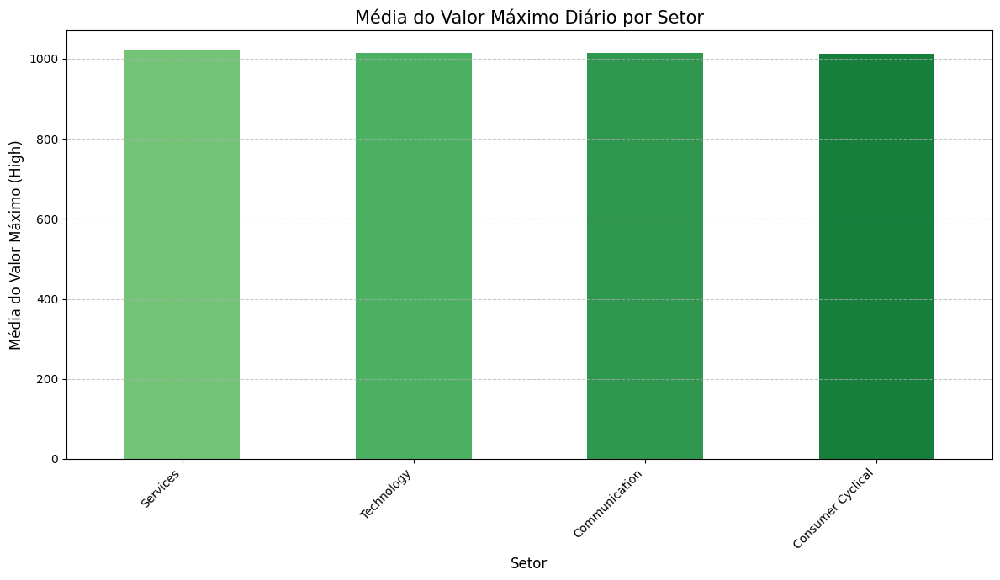

In [31]:
base_final_high = base_final.dropna(subset=['High', 'Sector'])
average_high_by_sector = base_final_high.groupby('Sector')['High'].mean().sort_values(ascending=False)

n_colors = 4
colors = plt.cm.Greens(np.linspace(0.5, 0.8, n_colors))  # Intervalo ajustado para evitar tons muito escuros

plt.figure(figsize=(12, 7))
average_high_by_sector.plot(kind='bar', color=colors)
plt.title('Média do Valor Máximo Diário por Setor', fontsize=15)
plt.xlabel('Setor', fontsize=12)
plt.ylabel('Média do Valor Máximo (High)', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Praticamente não há variação

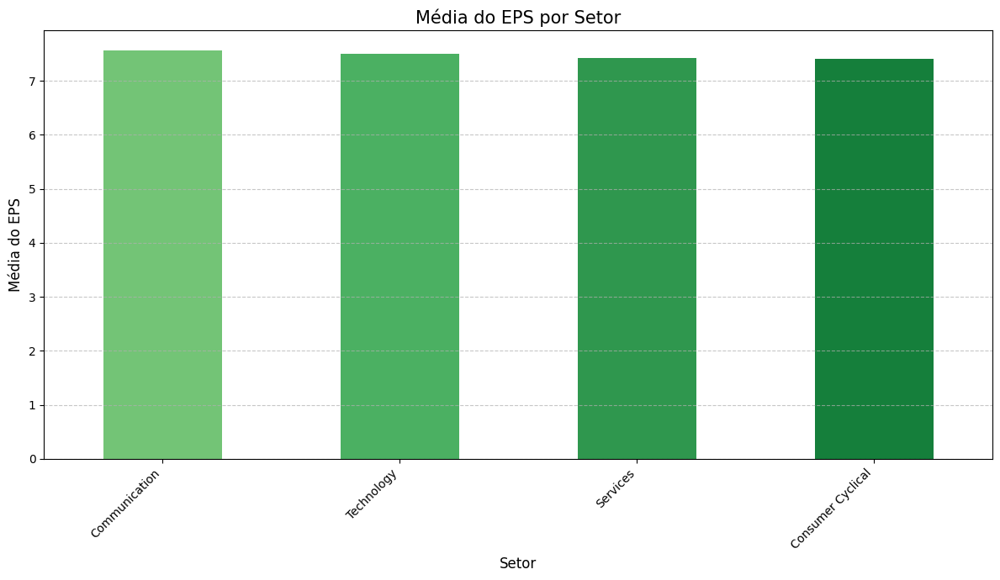

In [32]:
base_final_eps = base_final.dropna(subset=['EPS', 'Sector'])
average_eps_by_sector = base_final_eps.groupby('Sector')['EPS'].mean().sort_values(ascending=False)

n_colors = 4
colors = plt.cm.Greens(np.linspace(0.5, 0.8, n_colors))  # Intervalo ajustado para evitar tons muito escuros

plt.figure(figsize=(12, 7))
average_eps_by_sector.plot(kind='bar', color=colors)
plt.title('Média do EPS por Setor', fontsize=15)
plt.xlabel('Setor', fontsize=12)
plt.ylabel('Média do EPS', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Basicamente os mesmos valores

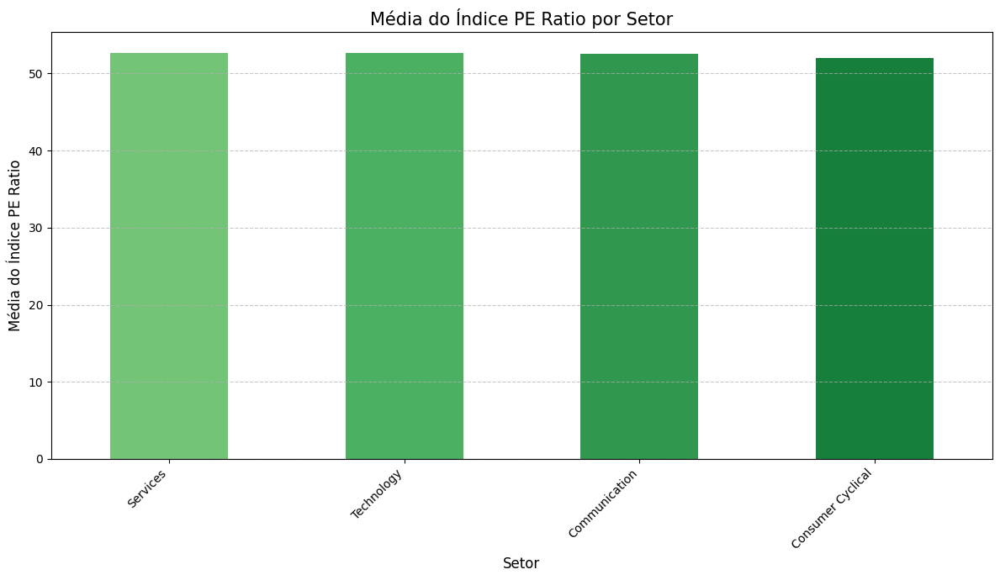

In [33]:
base_final_pe = base_final.dropna(subset=['PE Ratio', 'Sector'])
average_pe_by_sector = base_final_pe.groupby('Sector')['PE Ratio'].mean().sort_values(ascending=False)

n_colors = 4
colors = plt.cm.Greens(np.linspace(0.5, 0.8, n_colors))  # Intervalo ajustado para evitar tons muito escuros

plt.figure(figsize=(12, 7))
average_pe_by_sector.plot(kind='bar', color=colors)
plt.title('Média do Índice PE Ratio por Setor', fontsize=15)
plt.xlabel('Setor', fontsize=12)
plt.ylabel('Média do Índice PE Ratio', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Mesmo comportamento aqui

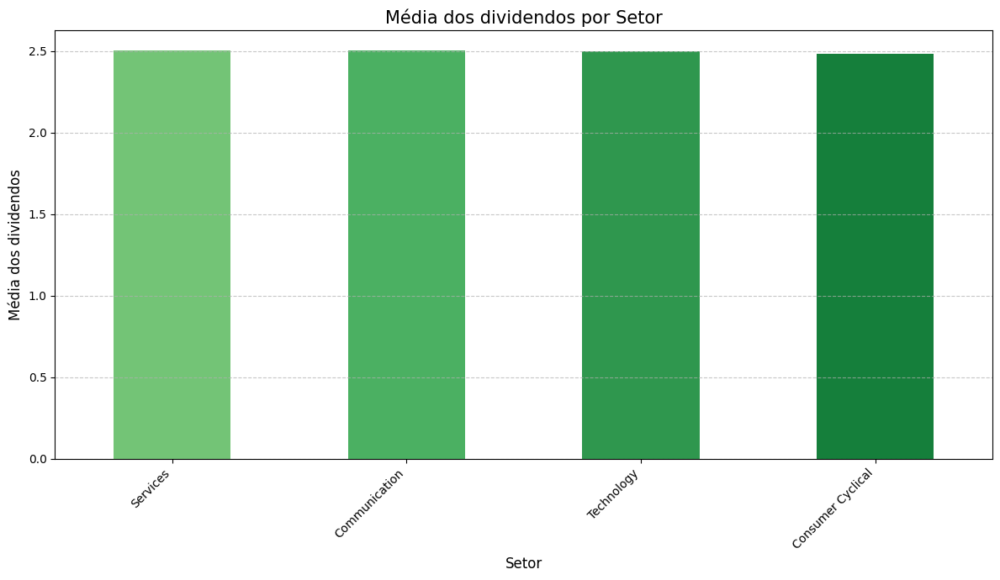

In [34]:
base_final_dividend = base_final.dropna(subset=['Dividend', 'Sector'])
average_dividend_by_sector = base_final_dividend.groupby('Sector')['Dividend'].mean().sort_values(ascending=False)

n_colors = 4
colors = plt.cm.Greens(np.linspace(0.5, 0.8, n_colors))  # Intervalo ajustado para evitar tons muito escuros

plt.figure(figsize=(12, 7))
average_dividend_by_sector.plot(kind='bar', color=colors)
plt.title('Média dos dividendos por Setor', fontsize=15)
plt.xlabel('Setor', fontsize=12)
plt.ylabel('Média dos dividendos', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Variação praticamente nula

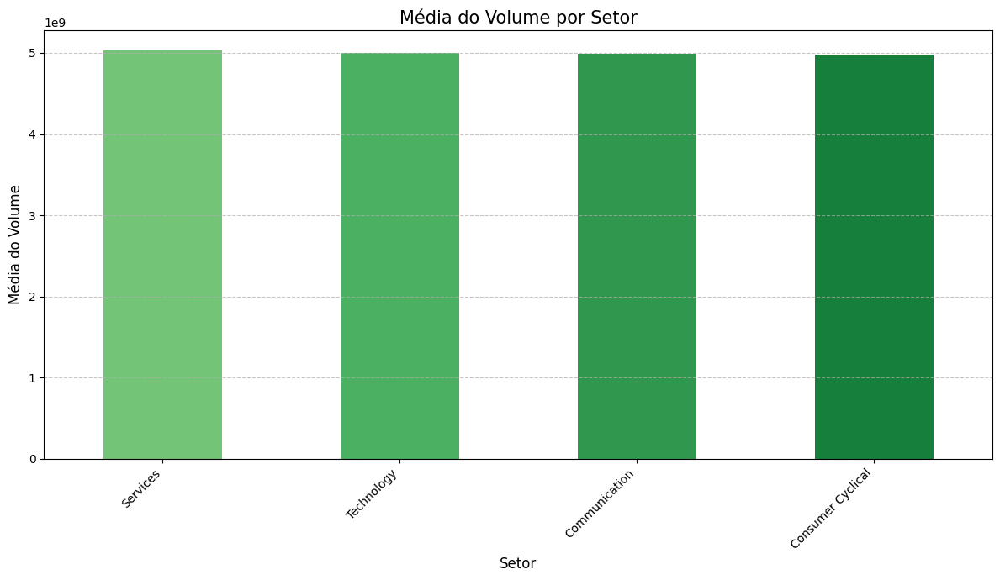

In [35]:
base_final_volume = base_final.dropna(subset=['Volume', 'Sector'])
average_volume_by_sector = base_final_volume.groupby('Sector')['Volume'].mean().sort_values(ascending=False)

n_colors = 4
colors = plt.cm.Greens(np.linspace(0.5, 0.8, n_colors))  # Intervalo ajustado para evitar tons muito escuros

plt.figure(figsize=(12, 7))
average_volume_by_sector.plot(kind='bar', color=colors)
plt.title('Média do Volume por Setor', fontsize=15)
plt.xlabel('Setor', fontsize=12)
plt.ylabel('Média do Volume', fontsize=12)
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.yticks(fontsize=10)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Padrão se repete aqui também

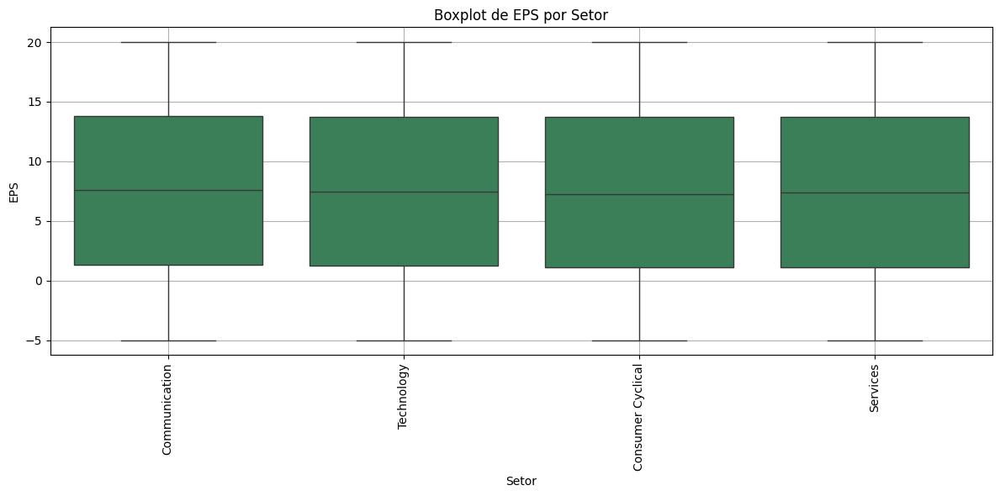

In [36]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=base_final, x="Sector", y='EPS', color ="seagreen")
plt.title("Boxplot de EPS por Setor")
plt.xlabel("Setor")
plt.ylabel("EPS")
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()

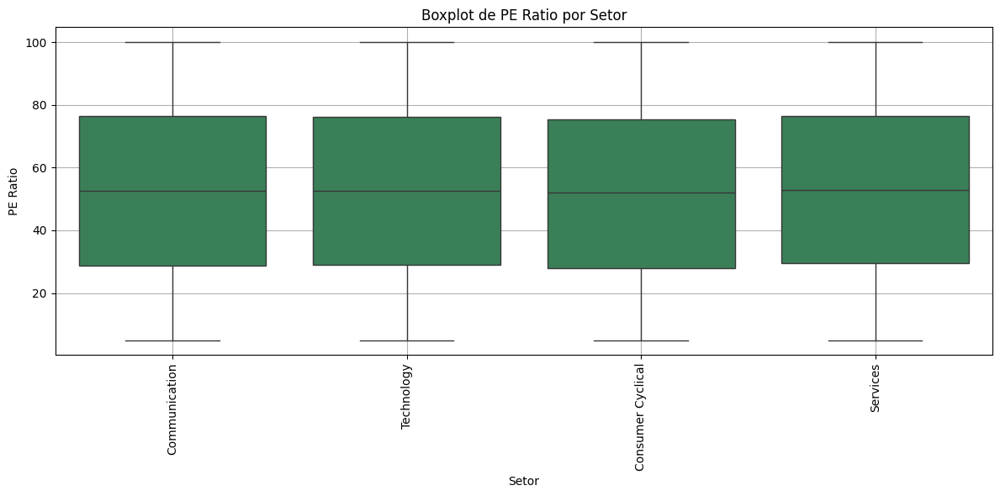

In [37]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=base_final, x="Sector", y='PE Ratio', color="seagreen")
plt.title("Boxplot de PE Ratio por Setor")
plt.xlabel("Setor")
plt.ylabel("PE Ratio")
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()

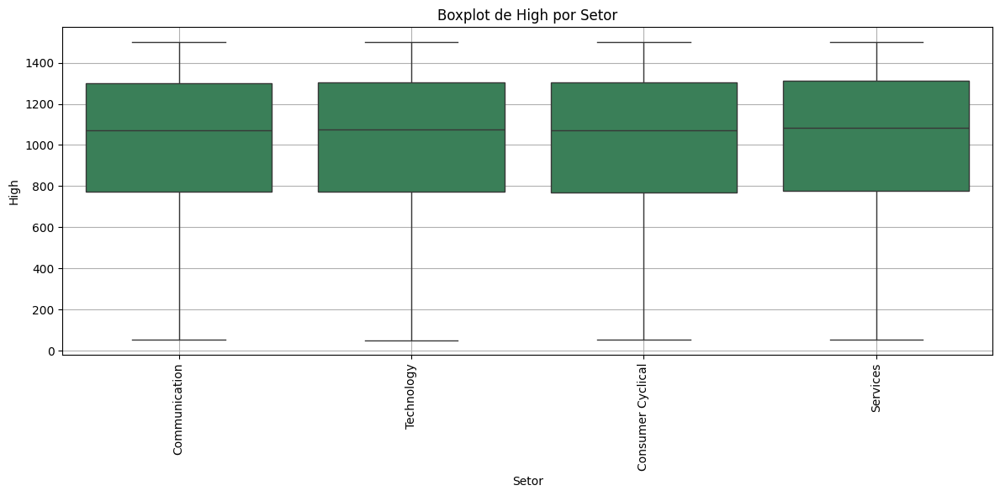

In [38]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=base_final, x="Sector", y='High', color="seagreen")
plt.title("Boxplot de High por Setor")
plt.xlabel("Setor")
plt.ylabel("High")
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()

Assim como nos gráficos de barras, os boxplots também mostram comportamento parecido, onde a varição de dados entre os setores é praticamente nula. Isso nos mostra que os setores influeciam pouco no desempenho das ações

Vamos fazer agora análises sazonais, para ver se é possível com base na variação ao longo do tempo, perceber algum padrão de comportamento das ações com base nos diferentes setores

In [39]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'EPS', 'Sector'], inplace=True)

# Calcular a mediana anual do EPS por setor
# Agrupar por Ano e industria e calcular a mediana do EPS
eps_anual_por_setor = df.groupby(['Ano', 'Sector'])['EPS'].median().reset_index()

# Calcular a variação anual do EPS (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada setor
eps_anual_por_setor = eps_anual_por_setor.sort_values(by=['Sector', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada setor
eps_anual_por_setor['Variacao_EPS_%'] = eps_anual_por_setor.groupby('Sector')['EPS'].pct_change() * 100


# Visualização para os setores
setores_para_visualizar = eps_anual_por_setor['Sector'].unique()[:4]

# Filtrar dados para os setores selecionados
eps_vis = eps_anual_por_setor[eps_anual_por_setor['Sector'].isin(setores_para_visualizar)].dropna(subset=['Variacao_EPS_%'])

if not eps_vis.empty:
    fig = px.line(
        eps_vis,
        x='Ano',
        y='Variacao_EPS_%',
        color='Sector',
        title='Variação Percentual Anual Mediana do EPS por setor',
        labels={'Variacao_EPS_%': 'Variação Anual EPS (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual EPS (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de EPS para visualizar nos setores selecionados.")



No período analisado, a maior parte dos dados se mantém na mesma faixa de variação (entre 5 e -5), com alguns anos pontuais saindo dessa margem. Destaque para a o setor de serviços, que obteve um desempenho abaixo do esperado em 2021, mas logo em seguida se recuperou

In [40]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'PE Ratio', 'Sector'], inplace=True)

# Calcular a mediana anual do PE Ratio por setor
# Agrupar por Ano e setor e calcular a mediana do PE Ratio
PERatio_anual_por_setor = df.groupby(['Ano', 'Sector'])['PE Ratio'].median().reset_index()

# Calcular a variação anual do PE Ratio (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada setor
PERatio_anual_por_setor = PERatio_anual_por_setor.sort_values(by=['Sector', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada setor
PERatio_anual_por_setor['Variacao_PE_Ratio_%'] = PERatio_anual_por_setor.groupby('Sector')['PE Ratio'].pct_change() * 100


# Visualização para setores
setores_para_visualizar = PERatio_anual_por_setor['Sector'].unique()[:4]

# Filtrar dados para os setores selecionados
PERatio_vis = PERatio_anual_por_setor[PERatio_anual_por_setor['Sector'].isin(setores_para_visualizar)].dropna(subset=['Variacao_PE_Ratio_%'])

if not eps_vis.empty:
    fig = px.line(
        PERatio_vis,
        x='Ano',
        y='Variacao_PE_Ratio_%',
        color='Sector',
        title='Variação Percentual Anual Mediana do PE Ratio por setor',
        labels={'Variacao_PE_Ratio_%': 'Variação Anual PE Ratio (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual PE Ratio (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de PE Ratio para visualizar nos setores selecionados.")

Mais uma vez destaque para o setor de serviços, que mostra uma variação maior em relação aos outros 3 setores

In [41]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'High', 'Sector'], inplace=True)

# Calcular a mediana anual do High por setor
# Agrupar por Ano e setor e calcular a mediana do High
high_anual_por_setor = df.groupby(['Ano', 'Sector'])['High'].median().reset_index()

# Calcular a variação anual do High (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada setor
high_anual_por_setor = high_anual_por_setor.sort_values(by=['Sector', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada setor
high_anual_por_setor['Variacao_High_%'] = high_anual_por_setor.groupby('Sector')['High'].pct_change() * 100


# Visualização para setores
setores_para_visualizar = high_anual_por_setor['Sector'].unique()[:4]

# Filtrar dados para os setores selecionados
high_vis = high_anual_por_setor[high_anual_por_setor['Sector'].isin(setores_para_visualizar)].dropna(subset=['Variacao_High_%'])

if not high_vis.empty:
    fig = px.line(
        high_vis,
        x='Ano',
        y='Variacao_High_%',
        color='Sector',
        title='Variação Percentual Anual Mediana do High por setor',
        labels={'Variacao_High_%': 'Variação Anual High (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual High (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de High para visualizar nos setores selecionados.")

In [42]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'Dividend', 'Sector'], inplace=True)

# Calcular a mediana anual do Dividend por setor
# Agrupar por Ano e setor e calcular a mediana do Dividend
dividend_anual_por_setor = df.groupby(['Ano', 'Sector'])['Dividend'].median().reset_index()

# Calcular a variação anual do Dividend (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada setor
dividend_anual_por_setor = dividend_anual_por_setor.sort_values(by=['Sector', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada setor
dividend_anual_por_setor['Variacao_Dividend_%'] = dividend_anual_por_setor.groupby('Sector')['Dividend'].pct_change() * 100


# Visualização para setores
setores_para_visualizar = dividend_anual_por_setor['Sector'].unique()[:4]

# Filtrar dados para os setores selecionados
dividend_vis = dividend_anual_por_setor[dividend_anual_por_setor['Sector'].isin(setores_para_visualizar)].dropna(subset=['Variacao_Dividend_%'])

if not dividend_vis.empty:
    fig = px.line(
        dividend_vis,
        x='Ano',
        y='Variacao_Dividend_%',
        color='Sector',
        title='Variação Percentual Anual Mediana do Dividend por setor',
        labels={'Variacao_Dividend_%': 'Variação Anual Dividend (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual Dividend (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de Dividend para visualizar nos setores selecionados.")

In [43]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'Volume', 'Sector'], inplace=True)

# Calcular a mediana anual do Volume por setor
# Agrupar por Ano e setor e calcular a mediana do Volume
volume_anual_por_setor = df.groupby(['Ano', 'Sector'])['Volume'].median().reset_index()

# Calcular a variação anual do Volume (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada setor
volume_anual_por_setor = volume_anual_por_setor.sort_values(by=['Sector', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada setor
volume_anual_por_setor['Variacao_Volume_%'] = volume_anual_por_setor.groupby('Sector')['Volume'].pct_change() * 100


# Visualização para alguns setores
setores_para_visualizar = volume_anual_por_setor['Sector'].unique()[:4] # Seleciona os primeiros 4 setores para exemplo

# Filtrar dados para os setores selecionados
volume_vis = volume_anual_por_setor[volume_anual_por_setor['Sector'].isin(setores_para_visualizar)].dropna(subset=['Variacao_Volume_%'])

if not volume_vis.empty:
    fig = px.line(
        volume_vis,
        x='Ano',
        y='Variacao_Volume_%',
        color='Sector',
        title='Variação Percentual Anual Mediana do Volume por setor',
        labels={'Variacao_Volume_%': 'Variação Anual Volume (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual Volume (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de Volume para visualizar nos setores selecionados.")

#### **Indústrias**

Aqui, vamos coletar as diversas indústrias existentes em nosso dataset.

In [44]:
industrias = base_final['Industry'].dropna().unique().tolist()
print(industrias)

['Media & Interactive Services', 'Semiconductors', 'Software – Application', 'Internet Services', 'Auto Manufacturers', 'Entertainment', 'Credit Services', 'Professional Services', 'Internet Retail', 'Software – Infrastructure', 'Computer Hardware', 'Information Technology Services', 'Communication Equipment']


A partir disso, vamos coletar algumas métricas específicas de cada uma dessas indústrias.

Dentre essas métricas, optamos por pegar aquelas que mais refletem o desempenho da ação:

* EPS -> Lucro por ação -> Rentabilidade da empresa
* P/E Ratio -> Relação Preço/Lucro
* Dividend -> Valor do dividendo distribuído por ação
* Volume -> Dinheiro movimentado por uma ação -> Consegue nos mostrar o interesse do mercado por ações da indústria
* Day Range -> Quanto aquela ação variou em um dia -> Mede a votatilidade de cada indústria

Iniciaremos pegando as informações mais importantes das métricas

In [45]:
resumo_numerico = base_final.groupby('Industry').agg({
    'EPS': ['mean', 'median'],
    'Dividend': ['mean', 'median'],
    'PE Ratio': ['mean','median'],
    'Day Range': ['mean','median'],
    'Volume': ['mean', 'median']
})

print(resumo_numerico)

                                      EPS         Dividend          PE Ratio  \
                                     mean median      mean median       mean   
Industry                                                                       
Auto Manufacturers               7.466479  7.430  2.467726   2.45  52.310478   
Communication Equipment          7.532636  7.600  2.508818   2.51  53.185915   
Computer Hardware                7.451384  7.490  2.506514   2.52  52.457925   
Credit Services                  7.489557  7.450  2.491362   2.49  52.547893   
Entertainment                    7.596752  7.650  2.483252   2.48  52.575415   
Information Technology Services  7.468744  7.410  2.528823   2.52  52.198837   
Internet Retail                  7.374886  7.170  2.492873   2.48  51.783652   
Internet Services                7.481317  7.390  2.500852   2.48  52.885570   
Media & Interactive Services     7.564697  7.585  2.511532   2.51  52.521121   
Professional Services            7.42437

Uma vez que temos esses dados, vamos mostrar os gráficos para cada métrica.

---
##### **EPS**

Nossa primeira métrica a ser comparada entre as indústrias será a EPS, vamos mostrar a mediana para cada indústria:

In [46]:
mediana_EPS = resumo_numerico['EPS']['median'].sort_values(ascending=False)

#Convertendo a Series em DataFrame
df_eps = mediana_EPS.reset_index()
df_eps.columns = ['Industry', 'EPS']

# Cria o gráfico com Plotly Express
fig = px.bar(
    df_eps,
    x='EPS',
    y='Industry',
    orientation='h', #Definindo que serão barras horizontais - Melhor visualização
    title='EPS por Indústria',
    text='EPS'
)

fig.update_traces(
    texttemplate='%{text:.2f}',
    textposition='inside',
    marker_color='seagreen'
)

fig.update_layout(
    xaxis_title='EPS (Mediana)',
    yaxis_title='Indústrias',
    margin=dict(l=100, r=40, t=60, b=60)
)

fig.show()

Medianas independentes das indústrias muito próximas.

Agora, mostraremos boxplots para compreendermos mais sobre a distribuição da EPS nas diferentes indústrias.

In [47]:
#Criando BoxPlot

fig = px.box(
    base_final,
    x="Industry",
    y="EPS",
    title="Boxplot de EPS por Indústria",
    color_discrete_sequence=["seagreen"]
)

# Ajustes de layout e rotação dos rótulos do eixo X
fig.update_layout(
    xaxis_tickangle=-90,
    title_x=0.5,
    margin=dict(l=40, r=40, t=80, b=80),
    yaxis_title="EPS",
    xaxis_title="Indústria"
)

fig.show()


Notamos como temos uma distribuição homogênea e similar para a EPS, independente das indústrias.

---
##### **P/E Ratio**

Agora, vamos calcular a mediana P/E Ratio por indústria e as comparar em um gráfico

In [48]:
mediana_PE_Ratio = resumo_numerico['PE Ratio']['median'].sort_values(ascending=False)

df_pe = mediana_PE_Ratio.reset_index()
df_pe.columns = ['Industry', 'PE Ratio']

fig = px.bar(
    df_pe,
    x='PE Ratio',
    y='Industry',
    orientation='h',
    title='P/E Ratio por Indústria',
    text='PE Ratio'
)

# Ajusta os rótulos e layout
fig.update_traces(
    texttemplate='%{text:.2f}',
    textposition='inside',
    marker_color='seagreen'
)

fig.update_layout(
    xaxis_title='P/E Ratio ($)',
    yaxis_title='Indústrias',
    margin=dict(l=100, r=40, t=60, b=60)
)

fig.show()


Podemos notar como os valores absolutos independente da indústria estão próximos.

Agora, vamos analisar os boxplots de cada indústria em relação ao P/E Ratio, para entendermos melhor como se dá a distribuição de cada.

In [49]:
fig = px.box(
    base_final,
    x="Industry",
    y="PE Ratio",
    title="Boxplot de P/E Ratio por Indústria",
    color_discrete_sequence=["seagreen"]
)

fig.update_layout(
    xaxis_tickangle=-90,
    title_x=0.5,
    margin=dict(l=40, r=40, t=80, b=80)
)

fig.show()


Mais uma vez, conseguimos notar comportamentos semelhantes, além da mediana, a distribuição dos dados com relação ao P/E Ratio em cada indústria se mostram muito próximos.

---
##### **Day Range**

Agora, vamos ver quais indústrias apresentam maior volatilidade

In [50]:
mediana_day_range = resumo_numerico['Day Range']['median'].sort_values(ascending=False)

df_mediana = mediana_day_range.reset_index()
df_mediana.columns = ['Industry', 'Day Range']

fig = px.bar(
    df_mediana,
    x='Day Range',
    y='Industry',
    orientation='h',
    title='Day Range por Indústria',
    text='Day Range',
)

# Atualiza o layout e formata os textos
fig.update_traces(texttemplate='%{text:.2f}',
                  textposition='inside',
                  marker_color='seagreen')

fig.update_layout(
    xaxis_title='Day Range ($)',
    yaxis_title='Indústrias',
    margin=dict(l=100, r=20, t=60, b=60)
)

fig.show()

Notamos como todas as indústrias mais uma vez, possuem métricas parecidas.
Vamos analisar a distribuição dos dados:

In [51]:
fig = px.box(
    base_final,
    x="Industry",
    y="Day Range",
    title="Boxplot de Day Range por Indústria",
    color_discrete_sequence=["seagreen"]
    )

# Ajuste da rotação dos rótulos do eixo X
fig.update_layout(
    xaxis_tickangle=-90,
    title_x=0.5,
    margin=dict(l=40, r=40, t=80, b=80)
)

# Exibe o gráfico
fig.show()


Podemos notar como as diferenças são sutis.

##### **Análise Anual**

Por fim, realizaremos uma análise com relação a variação do EPS em cada ano para algumas indústrias, de modo a conseguirmos identificar algum padrão. Optamos por mostrar apenas 4 indústrias de modo a termos um gráfico mais limpo e de fácil visualização. As 4 indústrias foram escolhidas sem critério, uma vez que ao gerarmos o gráfico com todas elas, podemos facilmente notar nossa conclusão que vem logo abaixo.

In [52]:
# Converter a coluna de data e extrair o ano
base_final['Date'] = pd.to_datetime(base_final['Date'], errors='coerce')
base_final['Ano'] = base_final['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
base_final.dropna(subset=['Date', 'EPS', 'Industry'], inplace=True)

# Calcular a mediana anual do EPS por industria
# Agrupar por Ano e industria e calcular a mediana do EPS
eps_anual_por_industria = base_final.groupby(['Ano', 'Industry'])['EPS'].median().reset_index()

# Calcular a variação anual do EPS (em relação ao ano anterior)
# Ordenar para garantir que o shift funcione corretamente dentro de cada industria
eps_anual_por_industria = eps_anual_por_industria.sort_values(by=['Industry', 'Ano'])

# Calcular a variação percentual em relação ao ano anterior dentro de cada industria
eps_anual_por_industria['Variacao_EPS_%'] = eps_anual_por_industria.groupby('Industry')['EPS'].pct_change() * 100


# Visualização para algumas industrias
industria_para_visualizar = eps_anual_por_industria['Industry'].unique()[:4] # Seleciona as primeiras 4 industrias para exemplo

# Filtrar dados para as industrias selecionados
eps_vis = eps_anual_por_industria[eps_anual_por_industria['Industry'].isin(industria_para_visualizar)].dropna(subset=['Variacao_EPS_%'])

if not eps_vis.empty:
    fig = px.line(
        eps_vis,
        x='Ano',
        y='Variacao_EPS_%',
        color='Industry',
        title='Variação Percentual Anual Mediana do EPS por Industria',
        labels={'Variacao_EPS_%': 'Variação Anual EPS (%)', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Variação Anual EPS (%)', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes com variação de EPS para visualizar nas industrias selecionados.")



A partir desse gráfico podemos notar que as indústrias possuem distinções quanto a variação do EPS anual, significando que em determinados anos, algumas indústrias possuem melhor performance do que
as outras.

---
##### **Conclusão sobre a associação industrial e o desempenho das ações**

Ao analisarmos as 3 métricas escolhidas, seus valores medianos e o modo como seus dados se distribuem, podemos notar que indepedente da indústria escolhida, para uma mesma métrica, os dados tendem a ter um alto grau de semelhança, seja em sua distribuição ou em seus valores médios.

Entretanto, só olhar para os valores absolutos sem considerar o contexto podemos deixar informações passarem batidas, já que por exemplo:

Um mesmo valor de EPS para diferentes indústrias podem possuir significados diferentes, de acordo com o contexto de cada. O que isso significa? Um mesmo valor de EPS pode ser muito bom para uma indústria, enquanto para outra nem tanto. (Falaremos mais disso mais a frente, em uma outra pergunta)

Também podemos notar que algumas indústrias são mais consistentes de modo anual (Caso da indústria Credit Services) enquanto outras possuem alguns picos e depois caem (Caso da Auto Manufactures).

Esse fato está intresicamente ligado a eventos externos que movimentam a indústria e acabam ocasionando esse tipo de situação. Apesar disso, todas as indústrias possuem seus altos e baixos e como confirmado pelos demais gráficos, ao olharmos para o longo prazo, notamos que todas elas tendem a ter números semelhantes e que nenhuma indústria consegue se sobressair as outras de modo constante.


---
### **Pergunta 3: Como o volume de negociações e os dividendos distribuídos se comportam entre diferentes setores e ao longo do tempo?**


-> Para responder essa pergunta, faremos análises relacionando a coluna Volume/Dividend com a coluna Date + análises dos Sector com as colunas Date e Volume/Dividend

---
#### **Análise relação Volume x Date**

-> Começaremos analisando o comportamento temporal do volume mediano de negociações:

In [53]:
def Constroi_grafico_date(coluna):
      # Criar base temporária
      aux = base_final.copy()

      # Garantir que a coluna de data esteja em formato datetime
      aux['Date'] = pd.to_datetime(aux['Date'])

      # Agrupar por mês e calcular a média do volume
      volume_mensal = aux.groupby(aux['Date'].dt.to_period('M'))[coluna].median().reset_index()
      volume_mensal['Date'] = volume_mensal['Date'].dt.to_timestamp()

      # Usar uma cor da paleta Seaborn
      cor_seaborn = sns.color_palette("deep")[0]

      # Criar gráfico com Plotly
      import plotly.graph_objects as go # Import plotly.graph_objects as go
      fig = go.Figure()
      fig.add_trace(go.Scatter(
          x=volume_mensal['Date'],
          y=volume_mensal[coluna],
          mode='lines',
          line=dict(color='seagreen'),
          name=f"{coluna}Mediano Mensal"
      ))

      fig.update_layout(
          title=f"Comportamento Temporal do {coluna} de Negociações",
          xaxis_title='Data',
          yaxis_title=f"{coluna} Mediano",
          template='plotly_white',
          height=500,
          width=1000
      )

      fig.show()

In [54]:
Constroi_grafico_date('Volume')

**Conclusões**

- O mercado manteve um nível relativamente constante e sem muitas variações significativas de negociações ao longo de quase uma década.

- Houve um aumento significativo no volume de negociações em 2025, indicando maior interesse dos investidores. Isso pode ter sido causado por:

  - Divulgação de resultados financeiros positivos
  - Anúncios econômicos ou políticos relevantes

- Apesar na queda abrupta em agosto de 2025, que pode ter sido causada por realização de lucros após o pico, fatores macroeconômicos negativos ou exaustão do volume especulativo, o mercado apresenteu uma rápida recuperação, reforçando uma maturidade vista desde 2015

**Insights**

- Maturidade do mercado ou ausência de grandes eventos disruptivos nesse período
- Indício de que as ações comerciais nesse intervalo focaram em constância e fidelização
- Recomendação de itensificação de estratégias de marketing com foco no aumento de visibilidade para alavancar as vendas



---
##### **Análise relação Volume x Meses no período analisado**

-> Vamos analisar o comportamento geral volume mediano de negociações nos meses do ano para saber os principais meses de vendas

In [55]:
# Analisar comportamento mediano do volume de negociações nos meses do ano
aux = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
aux['Date'] = pd.to_datetime(aux['Date'])

# Extrair o mês
aux['Month'] = aux['Date'].dt.month

# Calcular a mediana do volume por mês
volume_por_mes = aux.groupby('Month')['Volume'].sum().reset_index()

# Mapear números dos meses para nomes
month_names = {
    1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho',
    7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'
}
volume_por_mes['Month Name'] = volume_por_mes['Month'].map(month_names)

# Ordenar por mês para o gráfico
volume_por_mes = volume_por_mes.sort_values('Month')

# Criar gráfico de barras interativo com Plotly
fig = px.bar(
    volume_por_mes,
    x='Month Name',
    y='Volume',
    title='Volume Total de Negociações por Mês',
    labels={'Month Name': 'Mês', 'Volume': 'Volume Total'},
    text='Volume',
    template='plotly_white',
    color_discrete_sequence=['seagreen']
)

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(xaxis_title='Mês', yaxis_title='Volume', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[70.60e12, 90.50e12])
fig.show()


# Calcular a mediana do volume por mês
volume_por_mes = aux.groupby('Month')['Volume'].median().reset_index()

# Mapear números dos meses para nomes
month_names = {
    1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho',
    7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'
}
volume_por_mes['Month Name'] = volume_por_mes['Month'].map(month_names)

# Ordenar por mês para o gráfico
volume_por_mes = volume_por_mes.sort_values('Month')

# Criar gráfico de barras interativo com Plotly
fig = px.bar(
    volume_por_mes,
    x='Month Name',
    y='Volume',
    title='Volume Mediano de Negociações por Mês',
    labels={'Month Name': 'Mês', 'Volume': 'Volume Mediano'},
    text='Volume',
    template='plotly_white',
    color_discrete_sequence=['seagreen']
)

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(xaxis_title='Mês', yaxis_title='Volume', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[4.60e9, 5.15e9])
fig.show()




**Conclusões**

- O volume total é mais alto no início do ano (Janeiro–Março) e sobe novamente em Junho e Dezembro, sugerindo picos semestrais de atividade

- Novembro e Setembro mostram menos movimentação, podendo indicar períodos de baixa atividade no mercado

- Dezembro, Janeiro, e Março também se destacam nos valores medianos, reforçando que não apenas o volume total, mas também o valor "típico" das negociações é alto nesses meses

-  O valor "típico" (mediana) das negociações é relativamente constante durante o ano, indicando maturidade do mercado

**Insights**

- Janeiro, Março e Dezembro: mais movimentados e com negociações de valores mais altos, sendo potenciais alvos para ações comerciais ou estratégias de alocação de recursos

- Novembro: Baixo tanto em volume toal quanto em valor mediano. Pode ser um período de menor interesse do mercado, férias ou reavaliação de portfólios, sendo necessário avaliar estratégias para estimular o mercado nesses meses





---
#### **Análise Volume x Sector x Date**

-> Agora, analisaremos o desempenho dos principais setores ao longo do tempo em relação ao volume de vendas

In [56]:
def constroi_barra(coluna, onde = 'Sector'):
      # Análise da mediana do volume de vendas por setor (gráfico de barras deitado, decrescente)
      volume_mediana_por_setor = base_final.groupby(onde)[coluna].median().reset_index()
      volume_mediana_por_setor = volume_mediana_por_setor.sort_values(by=coluna, ascending=False)

      # Variar as cores de azul claro para verde seagreen
      cores_mediana = sns.color_palette("YlGnBu", len(volume_mediana_por_setor))

      fig_mediana = px.bar(
          volume_mediana_por_setor,
          x=coluna,
          y=onde,
          orientation='h', # Gráfico de barras deitado
          title='Mediana do Volume de Vendas por Setor',
          labels={coluna: 'Mediana do Volume de Vendas (em B)', onde: 'Setor'},
          text=coluna,
          template='plotly_white',
          color=coluna, # Variar a cor com base no valor
          color_continuous_scale=[(0, 'lightblue'), (1, 'seagreen')] # Escala de cores do azul claro para o verde seagreen
      )

      # Ajustar o range do eixo X (Volume) para variar de 4.90B a 5.20B
      fig_mediana.update_layout(xaxis_range=[4.90e9, 5.20e9]) # 4.90B = 4.90e9, 5.20B = 5.20e9

      fig_mediana.update_traces(texttemplate='%{text:.2s}', textposition='outside')
      fig_mediana.update_layout(yaxis={'categoryorder':'total ascending'}) # Ordenar decrescente no eixo Y
      fig_mediana.show()


      # Análise do somatório do volume de vendas por setor (gráfico de barras deitado, decrescente)
      volume_somatorio_por_setor = base_final.groupby(onde)[coluna].sum().reset_index()
      volume_somatorio_por_setor = volume_somatorio_por_setor.sort_values(by=coluna, ascending=False)

      # Variar as cores de azul claro para verde seagreen
      cores_somatorio = sns.color_palette("YlGnBu", len(volume_somatorio_por_setor))

      fig_somatorio = px.bar(
          volume_somatorio_por_setor,
          x=coluna,
          y=onde,
          orientation='h', # Gráfico de barras deitado
          title='Somatório do Volume de Vendas por Setor',
          labels={coluna: 'Somatório do Volume de Vendas (em T)', onde: 'Setor'},
          text=coluna,
          template='plotly_white',
          color=coluna, # Variar a cor com base no valor
          color_continuous_scale=[(0, 'lightblue'), (1, 'seagreen')] # Escala de cores do azul claro para o verde seagreen
      )

      fig_somatorio.update_traces(texttemplate='%{text:.2s}', textposition='outside')
      fig_somatorio.update_layout(yaxis={'categoryorder':'total ascending'}) # Ordenar decrescente no eixo Y
      fig_somatorio.show()
constroi_barra('Volume')

**Conclusões:**

- O setor de Services, mesmo menos relevante no volume total, possui vendas medianas maiores, indicando que quando ocorrem, as transações nesse setor tendem a ser de valor mais alto por venda

- O setor de Technology domina significamente o volume total com 600T, representando mais da metade de tudo negociado

- Mesmo que a mediana de volume de Communication e Technology sejam próximos, o volume total elevado aponta para uma intensidade maior de transações nesses setores

- Consumer Cyclical com mediana padrão e volume total relativamente baixo pode indicar um setor com participação moderada

**Insights:**

- Technology é o setor mais líquido, ou seja, ideal para estratégias de curto prazo e negociação frequente

- Services pode ser interessante para alocações de valor ou operações pontuais de alto impacto



---
##### **Principais sectors x volume x date**

-> Agora analisaremos mais separadamente a relação dos principais setores para investimento em relaçao ao volume ao longo do tempo

---
###### **Sector Technology**

In [57]:
def setor_vs_coluna(coluna, alvo='Volume'):
      tmpp = base_final.copy()
      # Converter a coluna de data
      tmpp['Date'] = pd.to_datetime(tmpp['Date'])

      # Extrair o ano
      tmpp['Ano'] = tmpp['Date'].dt.year

      # Filtrar o setor de Technology
      df_technology = tmpp[tmpp['Sector'] == coluna].copy()

      # Calcular a mediana do Volume por ano para o setor Technology
      mediana_volume_technology_anual = df_technology.groupby('Ano')[alvo].median().reset_index()

      # Criar o gráfico de linha com Plotly
      fig = px.line(
          mediana_volume_technology_anual,
          x='Ano',
          y=alvo,
          title=f'Mediana Anual do Volume de Negociações para o Setor {coluna}',
          labels={alvo: 'Mediana do Volume (em B)', 'Ano': 'Ano'},
          markers=True,
          template='plotly_white'
      )

      # Atualizar a cor da linha para 'seagreen'
      fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

      # Formatar o eixo Y para exibir em bilhões (B)
      fig.update_layout(yaxis=dict(tickformat=".2s", title='Mediana do Volume'))

      fig.show()
setor_vs_coluna('Technology')

**Conclusões:**

- O setor apresenta ciclos de subida e queda, provavelmente ligado a ciclos de inovação e lançamentos tecnológicos

- Alta consistência entre 2020 e 2024, sinalizando resiliência e atratividade

- Mesmo com leve queda em 2025, continua em patamar estável



---
###### **Sector Services**

In [58]:
setor_vs_coluna('Services')

**Conclusões:**

- O setor de Services apresenta padrão constante, sugerindo maturidade e transações regulares ao longo dos anos

- O crescimento forte em 2025 indica possível transformação no setor, como digitalização ou concentração de mercado

- Combinado ao dado anterior de maior mediana geral entre os setores, reforça a conclusão de que esse setor tem relativamente poucas mas valiosas transações




---
###### **Sector Consumer Cyclical**

In [59]:
setor_vs_coluna('Consumer Cyclical')

**Conclusões:**

- O setor é cíclico por natureza, o que reflete em medianas altamente variáveis

- Indica forte influência de fatores econômicos macro, como consumo e renda disponível

- Exige mais atenção para timing de investimento — pode oferecer oportunidades, mas com maior risco

---
###### **Sector Communication**

In [60]:
setor_vs_coluna('Communication')

In [61]:
tmpp = base_final.copy()

# Converter a coluna de data
tmpp['Date'] = pd.to_datetime(tmpp['Date'])

# Extrair o ano
tmpp['Ano'] = tmpp['Date'].dt.year

# Filtrar o setor de Technology
df_technology = tmpp[tmpp['Sector'] == 'Technology'].copy()

# Calcular a mediana do Volume por ano para o setor Technology
mediana_volume_technology_anual = df_technology.groupby('Ano')['Volume'].median().reset_index()

# Criar o gráfico de linha com Plotly
fig = px.line(
    mediana_volume_technology_anual,
    x='Ano',
    y='Volume',
    title='Mediana Anual do Volume de Negociações para o Setor Technology',
    labels={'Volume': 'Mediana do Volume (em B)', 'Ano': 'Ano'},
    markers=True,
    template='plotly_white'
)

# Atualizar a cor da linha para 'seagreen'
fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

# Formatar o eixo Y para exibir em bilhões (B)
fig.update_layout(yaxis=dict(tickformat=".2s", title='Mediana do Volume'))

fig.show()


**Conclusões:**

- O setor apresenta ciclos de subida e queda, provavelmente ligado a ciclos de inovação e lançamentos tecnológicos

- Alta consistência entre 2020 e 2024, sinalizando resiliência e atratividade

- Mesmo com leve queda em 2025, continua em patamar estável



**Conclusões:**

- A mediana de volume é relativamente estável apesar de oscilações, sedno um setor com perfil moderado de volatilidade

- A queda acentuada em 2025 pode indicar redução na consistência de negociações ou mudança de foco dos investidores
---


---
#### **Análise relação Dividend x Date**

-> Começaremos analisando o comportamento temporal do dividendo mediano de negociações:

In [62]:
# Criar base temporária
aux_dividend = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
aux_dividend['Date'] = pd.to_datetime(aux_dividend['Date'])

# Agrupar por ano e calcular a mediana do dividendo
# Corrigido para agrupar por ano e calcular a mediana do dividendo, e ajustar o nome da variável
dividend_anual_mediana = aux_dividend.groupby(aux_dividend['Date'].dt.to_period('Y'))['Dividend'].median().reset_index()
dividend_anual_mediana['Date'] = dividend_anual_mediana['Date'].dt.to_timestamp()

# Criar gráfico com Plotly
import plotly.graph_objects as go # Importação necessária para go.Figure

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=dividend_anual_mediana['Date'],
    y=dividend_anual_mediana['Dividend'],
    mode='lines+markers',
    line=dict(color='seagreen'),
    name='Dividendo Mediano Anual'
))

fig.update_layout(
    title='Variação do Valor Mediano do Dividendo ao Longo dos Anos',
    xaxis_title='Ano',
    yaxis_title='Valor Mediano do Dividendo',
    template='plotly_white',
    height=500,
    width=1000
)

fig.show()


**Conclusões**

- O valor mediano dos dividendos permaneceu relativamente estável durante esse período, com o menor valor sendo uma pequena oscilação, em 2016, sugerindo uma possível desaceleração no pagamento de dividendos ou mudanças nas políticas de distribuição de lucros

- Ausência de tendência clara de crescimento ou queda, o que pode apontar para uma maturidade no mercado ou constância nas margens de lucro

**Insights**

- Mercado maturo e estável quanto aos dividendos, sendo um indicativo de empresas financeiramente saudáveis


---
##### **Análise relação Dividend x Meses no período analisado**

-> Vamos analisar o comportamento geral volume mediano de negociações nos meses do ano para saber os principais meses de vendas

In [63]:
# Analisar comportamento mediano do dividendo nos meses do ano
aux = base_final.copy()

# Garantir que a coluna de data esteja em formato datetime
aux['Date'] = pd.to_datetime(aux['Date'])

# Extrair o mês
aux['Month'] = aux['Date'].dt.month

# Calcular o SOMATÓRIO do Dividendo por mês
# O comentário indicava mediana de volume, mas o código calculava a SOMA de dividendos.
# Mantido o cálculo de soma do dividendo, ajustando o comentário e o título do gráfico.
dividend_total_por_mes = aux.groupby('Month')['Dividend'].sum().reset_index()

# Mapear números dos meses para nomes
month_names = {
    1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho',
    7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'
}
dividend_total_por_mes['Month Name'] = dividend_total_por_mes['Month'].map(month_names)

# Ordenar por mês para o gráfico
dividend_total_por_mes = dividend_total_por_mes.sort_values('Month')

# Criar gráfico de barras interativo com Plotly
import plotly.express as px # Importação necessária para px.bar

fig = px.bar(
    dividend_total_por_mes, # Usar o DataFrame corrigido
    x='Month Name',
    y='Dividend',
    title='Somatório de Dividendos Pagos por Mês', # Título corrigido
    labels={'Month Name': 'Mês', 'Dividend': 'Somatório de Dividendos'}, # Labels corrigidos
    text='Dividend',
    template='plotly_white',
    color_discrete_sequence=['seagreen']
)

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
# Ajustar o range do eixo Y se necessário com base nos dados reais
# fig.update_layout(xaxis_title='Mês', yaxis_title='Somatório de Dividendos', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[70.60e12, 90.50e12])
fig.update_layout(xaxis_title='Mês', yaxis_title='Somatório de Dividendos', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[39180.0, 44600.0])

fig.show()


# Calcular a MEDIANA do Dividendo por mês
# O comentário indicava mediana de volume, mas o código calculava a MEDIANA de dividendos.
# Mantido o cálculo de mediana do dividendo, ajustando o comentário e o título do gráfico.
dividend_mediano_por_mes = aux.groupby('Month')['Dividend'].median().reset_index()

# Mapear números dos meses para nomes
month_names = {
    1: 'Janeiro', 2: 'Fevereiro', 3: 'Março', 4: 'Abril', 5: 'Maio', 6: 'Junho',
    7: 'Julho', 8: 'Agosto', 9: 'Setembro', 10: 'Outubro', 11: 'Novembro', 12: 'Dezembro'
}
dividend_mediano_por_mes['Month Name'] = dividend_mediano_por_mes['Month'].map(month_names)

# Ordenar por mês para o gráfico
dividend_mediano_por_mes = dividend_mediano_por_mes.sort_values('Month')

# Criar gráfico de barras interativo com Plotly
fig = px.bar(
    dividend_mediano_por_mes, # Usar o DataFrame corrigido
    x='Month Name',
    y='Dividend',
    title='Dividendo Mediano Pago por Mês', # Título corrigido
    labels={'Month Name': 'Mês', 'Dividend': 'Dividendo Mediano'}, # Labels corrigidos
    text='Dividend',
    template='plotly_white',
    color_discrete_sequence=['seagreen']
)

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
# Ajustar o range do eixo Y se necessário com base nos dados reais
# fig.update_layout(xaxis_title='Mês', yaxis_title='Dividendo', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[4.60e9, 5.15e9])
fig.update_layout(xaxis_title='Mês', yaxis_title='Dividendo Mediano', uniformtext_minsize=8, uniformtext_mode='hide', yaxis_range=[2.44, 2.55])
fig.show()

**Conclusões**

- Valores altos, porém uma distribuição desigual ao longo do ano

-  A sazonalidade mais forte nos pagamentos são nos meses de Janeiro, Março e Junho, enquanto os mais fracos são Setembro e Novembro

- Padrão de valor mediano praticamente constante (2.5) durante quase todo o ano

- Mesmo nos meses com relativamente baixo somatório de dividendos pagos, o valor mediano pago por ação permanece constante, sugerindo que há menos empresas pagando, mas com valores consistente

**Insights**

- Para estratégias de otimização de fluxo de caixa via dividendos, priorizar ações com pagamento nos meses mais fortes pode aumentar o retorno recorrente

- A qualidade dos dividendos (mediana) é relativamente estável ao longo do ano mesmo quando o somatório varia





---
#### **Análise Dividend x Sector x Date**

-> Agora, analisaremos o desempenho dos principais setores ao longo do tempo em relação ao volume de vendas

In [64]:
# Análise da mediana do volume de vendas por setor (gráfico de barras deitado, decrescente)
Dividend_mediana_por_setor = base_final.groupby('Sector')['Dividend'].median().reset_index()
Dividend_mediana_por_setor = Dividend_mediana_por_setor.sort_values(by='Dividend', ascending=False)

# Variar as cores de azul claro para verde seagreen
cores_mediana = sns.color_palette("YlGnBu", len(Dividend_mediana_por_setor))

fig_mediana = px.bar(
    Dividend_mediana_por_setor,
    x='Dividend',
    y='Sector',
    orientation='h', # Gráfico de barras deitado
    title='Mediana do Dividend de Vendas por Setor',
    labels={'Dividend': 'Mediana do Dividend de Vendas (em B)', 'Sector': 'Setor'},
    text='Dividend',
    template='plotly_white',
    color='Dividend', # Variar a cor com base no valor
    color_continuous_scale=[(0, 'lightblue'), (1, 'seagreen')] # Escala de cores do azul claro para o verde seagreen
)

# Ajustar o range do eixo X (Dividend) para variar de 4.90B a 5.20B
#fig_mediana.update_layout(xaxis_range=[4.90e9, 5.20e9]) # 4.90B = 4.90e9, 5.20B = 5.20e9

fig_mediana.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig_mediana.update_layout(yaxis={'categoryorder':'total ascending'}) # Ordenar decrescente no eixo Y
fig_mediana.show()


# Análise do somatório do Dividend de vendas por setor (gráfico de barras deitado, decrescente)
Dividend_somatorio_por_setor = base_final.groupby('Sector')['Dividend'].sum().reset_index()
Dividend_somatorio_por_setor = Dividend_somatorio_por_setor.sort_values(by='Dividend', ascending=False)

# Variar as cores de azul claro para verde seagreen
cores_somatorio = sns.color_palette("YlGnBu", len(Dividend_somatorio_por_setor))

fig_somatorio = px.bar(
    Dividend_somatorio_por_setor,
    x='Dividend',
    y='Sector',
    orientation='h', # Gráfico de barras deitado
    title='Somatório do Dividend de Vendas por Setor',
    labels={'Dividend': 'Somatório do Dividend de Vendas (em T)', 'Sector': 'Setor'},
    text='Dividend',
    template='plotly_white',
    color='Dividend', # Variar a cor com base no valor
    color_continuous_scale=[(0, 'lightblue'), (1, 'seagreen')] # Escala de cores do azul claro para o verde seagreen
)

fig_somatorio.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig_somatorio.update_layout(yaxis={'categoryorder':'total ascending'}) # Ordenar decrescente no eixo Y
fig_somatorio.show()

**Conclusões:**

- O valor mediano de dividendos é uniforme, mas o volume total distribuído varia muito entre os setores

- Setores com maior somatório, Technology e Communication, devem ser priorizados por investidores que buscam maior retorno absoluto em dividendos

- Setores com menor somatório, Services e Consumer Cyclical, podem ser menos atrativos se o foco for volume de dividendos, mas ainda oferecem estabilidade no valor por ação

**Insights:**

- A qualidade dos dividendos por empresa (mediana) é semelhante entre os setores, o que indica que a escolha do setor pode ser mais relevante para volume total recebido do que para valor por ação



---
##### **Principais sectors x dividend x date**

-> Agora analisaremos mais separadamente a relação dos principais setores para investimento em relaçao ao volume ao longo do tempo

---
###### **Sector Technology**

In [65]:
# Convertendo a coluna de data
aux['Date'] = pd.to_datetime(aux['Date'])

# Extraindo o ano
aux['Ano'] = aux['Date'].dt.year

# Filtrando o setor de Technology
df_technology = aux[aux['Sector'] == 'Technology'].copy()

# Calculando a mediana do Dividend por ano para o setor Technology
mediana_Dividend_technology_anual = df_technology.groupby('Ano')['Dividend'].median().reset_index()

# Criando o gráfico de linha com Plotly
fig = px.line(
    mediana_Dividend_technology_anual,
    x='Ano',
    y='Dividend',
    title='Mediana Anual do Dividend para o Setor Technology',
    labels={'Dividend': 'Mediana do Dividend', 'Ano': 'Ano'},
    markers=True,
    template='plotly_white'
)

# Atualizando a cor da linha para 'seagreen'
fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

# Formatando o eixo Y e atualizando o título do eixo Y
fig.update_layout(yaxis=dict(title='Mediana do Dividend'))

fig.show()

**Conclusões:**

- Alta consistência do valor mediano anual do Dividend ao longo dos anos, com variações insignificantes



---
###### **Sector Services**

In [66]:
# Convertendo a coluna de data
aux['Date'] = pd.to_datetime(aux['Date'])

# Extraindo o ano
aux['Ano'] = aux['Date'].dt.year

# Filtrando o setor de Technology
df_technology = aux[aux['Sector'] == 'Services'].copy()

# Calculando a mediana do Dividend por ano para o setor Technology
mediana_Dividend_technology_anual = df_technology.groupby('Ano')['Dividend'].median().reset_index()

# Criando o gráfico de linha com Plotly
fig = px.line(
    mediana_Dividend_technology_anual,
    x='Ano',
    y='Dividend',
    title='Mediana Anual do Dividend para o Setor Services',
    labels={'Dividend': 'Mediana do Dividend', 'Ano': 'Ano'},
    markers=True,
    template='plotly_white'
)

# Atualizando a cor da linha para 'seagreen'
fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

# Formatando o eixo Y e atualizando o título do eixo Y
fig.update_layout(yaxis=dict(title='Mediana do Dividend'))

fig.show()

**Conclusões:**

- Oscilação um pouco maior comparado ao Sector Technology, mas com certa consistência do valor mediano anual do Dividend ao longo dos anos, permanecendo no padrão 2,5 e variando minimamente




---
###### **Sector Consumer Cyclical**

In [67]:
# Convertendo a coluna de data
aux['Date'] = pd.to_datetime(aux['Date'])

# Extraindo o ano
aux['Ano'] = aux['Date'].dt.year

# Filtrando o setor de Technology
df_technology = aux[aux['Sector'] == 'Consumer Cyclical'].copy()

# Calculando a mediana do Dividend por ano para o setor Technology
mediana_Dividend_technology_anual = df_technology.groupby('Ano')['Dividend'].median().reset_index()

# Criando o gráfico de linha com Plotly
fig = px.line(
    mediana_Dividend_technology_anual,
    x='Ano',
    y='Dividend',
    title='Mediana Anual do Dividend para o Setor Consumer Cyclical',
    labels={'Dividend': 'Mediana do Dividend', 'Ano': 'Ano'},
    markers=True,
    template='plotly_white'
)

# Atualizando a cor da linha para 'seagreen'
fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

# Formatando o eixo Y e atualizando o título do eixo Y
fig.update_layout(yaxis=dict(title='Mediana do Dividend'))

fig.show()

**Conclusões:**

- Alta consistência do valor mediano anual do Dividend ao longo dos anos, com variações insignificantes

---
###### **Sector Communication**

In [68]:
# Convertendo a coluna de data
aux['Date'] = pd.to_datetime(aux['Date'])

# Extraindo o ano
aux['Ano'] = aux['Date'].dt.year

# Filtrando o setor de Technology
df_technology = aux[aux['Sector'] == 'Communication'].copy()

# Calculando a mediana do Dividend por ano para o setor Technology
mediana_Dividend_technology_anual = df_technology.groupby('Ano')['Dividend'].median().reset_index()

# Criando o gráfico de linha com Plotly
fig = px.line(
    mediana_Dividend_technology_anual,
    x='Ano',
    y='Dividend',
    title='Mediana Anual do Dividend para o Setor Communication',
    labels={'Dividend': 'Mediana do Dividend', 'Ano': 'Ano'},
    markers=True,
    template='plotly_white'
)

# Atualizando a cor da linha para 'seagreen'
fig.update_traces(line=dict(color='seagreen', width=3), marker=dict(size=8))

# Formatando o eixo Y e atualizando o título do eixo Y
fig.update_layout(yaxis=dict(title='Mediana do Dividend'))

fig.show()

**Conclusões:**

- Alta consistência do valor mediano anual do Dividend ao longo dos anos, com variações insignificantes
---


##### **Conclusão geral da análise do dividend x sectors x date**

- Setor relativamente mais consistente: Communication, com tendência sólida de crescimento

- Setor relativamente mais volátil: Consumer Cyclical

- Setor relativamente mais propenso ao crescimento: Technology

- Setor relativamente mais sensível a eventos externos: Services

---
### **Pergunta 4: O que pode ser feito para otimizar as vendas?**


Para otimizarmos as vendas, primeiramente precisamos conhecer quais são as empresas que possuem melhores números de vendas e compreendermos melhor quais são as características delas.

Optamos pelo preço médio ser a divisão da soma de Open e Close pelo fato de que High e Low são extremos e não é comum que tenhamos alto volume de negociações nesses picos.

In [69]:
base_tmp = base_final.copy()

base_tmp['Numero de Vendas'] = base_tmp['Volume']/((base_tmp['Open'] + base_tmp['Close'])/2) #Dividindo o volume pelo preço médio para determinarmos o número de ações

acoes_ticker = base_tmp.groupby('Ticker')['Numero de Vendas'].sum().reset_index()

Agora iremos gerar um gráfico que nos mostrará o número de ações que cada empresa vendeu ao longo de todos os anos do dataset.

In [70]:
fig = px.bar(
    acoes_ticker,
    x='Ticker',
    y='Numero de Vendas',
    text='Numero de Vendas',
    title='Total de Ações Vendidas por Empresa',
    labels={'Numero de Vendas': 'Ações Vendidas', 'Ticker': 'Empresa'},
    color='Ticker'
)

# Ajusta layout
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

# Exibe o gráfico
fig.show()

Podemos notar que em geral, as empresas possuem números similares, entretanto, podemos pegar como base as 4 empresas que possuem mais ações vendidas e fazer uma análise delas, compreendendo quais são as estratégias adotadas por cada uma que impactam positivamente em suas vendas.

Optamos por 4 empresas pois ao olharmos o gráfico, notamos que 4 se sobressaem em seus números.

In [71]:
top4 = (
    base_tmp.groupby('Ticker')['Numero de Vendas']
    .sum() #Somando a quantidade de ações vendidas das 4 empresas durantes todos os anos
    .sort_values(ascending=False)
    .head(4)
    .reset_index()
)

fig = px.bar(
    top4,
    x='Ticker',
    y='Numero de Vendas',
    text='Numero de Vendas',
    title='Top 4 Empresas com Mais Ações Vendidas',
    labels={'Numero de Vendas': 'Ações Vendidas', 'Ticker': 'Empresa'},
    color='Ticker'
)

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

fig.show()

Nosso trabalho será em cima dessas 4 empresas. Agora, coletaremos um resumo numérico sobre algumas métricas importantes, afim de explicar por que essas empresas são as que possuem mais ações importantes.

In [72]:
resumo_numerico_ticker = base_final.groupby('Ticker').agg({
    'EPS': ['median'],
    'Dividend': ['median'],
    'PE Ratio': ['median'],
    'Day Range': ['median']
})

print(resumo_numerico_ticker)

          EPS Dividend PE Ratio Day Range
       median   median   median    median
Ticker                                   
AAPL    7.490     2.52   52.620   423.100
ADBE    7.400     2.43   53.350   423.380
AMD     7.650     2.50   53.235   422.935
AMZN    7.055     2.49   51.885   424.070
BABA    7.300     2.48   51.730   426.380
CRM     7.590     2.48   52.570   422.470
CSCO    7.600     2.51   53.390   418.920
DOCU    7.540     2.50   52.280   430.795
GOOG    7.390     2.48   52.920   434.630
IBM     7.410     2.52   52.025   432.965
INTC    7.320     2.52   51.405   419.105
INTU    7.590     2.48   52.610   434.470
LYFT    7.300     2.52   52.650   423.710
META    7.620     2.48   52.650   439.560
MSFT    7.500     2.47   52.410   418.200
NFLX    7.440     2.46   52.570   426.570
NVDA    7.450     2.48   52.690   423.310
ORCL    7.370     2.50   52.500   434.930
PINS    7.860     2.51   53.520   429.050
PYPL    7.400     2.50   53.250   422.090
SHOP    7.560     2.54   52.690   

Optamos por essas métricas pois:

Day Range → Útil para o investidor conhecer o seu risco, uma vez que mede a volatilidade das ações.

EPS → Mostra quanto de lucro a empresa gera por ação. É um bom indicativo de desempenho e rentabilidade.

PE Ratio  → Compara o preço da ação com o lucro por ação. Ajuda a entender se a ação está “cara” ou “barata” em relação aos lucros que a empresa gera.

Dividend → Valor do dividendo pago por cada ação da empresa. É interessante para quem busca uma renda passiva com ações.

Ou seja, métricas que de fato medem se as ações são interessantes ou não.

Geração do gráfico para a métrica EPS e coleta dos dados para os próximos gráficos que serão gerados

In [73]:
#Coletando as medianas de cada uma das 4 maiores empresas para uma das métricas
top4_tickers = top4['Ticker'].tolist()
top4_medianas = resumo_numerico_ticker.loc[top4_tickers].reset_index()
top4_medianas.columns = ['Ticker', 'EPS_Median', 'Dividend_Median', 'PE_Ratio_Median', 'Day_Range_Median']

#Calculamos a média das medianas de todas as empresas, referentes a métrica 'EPS'
media_eps_total = resumo_numerico_ticker['EPS'].mean().values[0]

#Criamos o gráfico
fig = px.bar(
    top4_medianas,
    x='Ticker',
    y='EPS_Median',
    title='Top 4 Empresas - Mediana de EPS vs Média Geral das Medianas',
    labels={'EPS_Median': 'EPS Mediano'},
    text='EPS_Median',
    color='Ticker'
)

#Linha horizontal da média de todas as empresas - Referência
fig.add_shape(
    type='line',
    x0=-0.5,
    x1=3.5,
    y0=media_eps_total,
    y1=media_eps_total,
    line=dict(color='red', dash='dash')
)

#Anotação da média
fig.add_annotation(
    xref='paper',
    x=1.01,
    y=media_eps_total,
    text=f'Média das Medianas (Geral): {media_eps_total:.2f}',
    showarrow=False,
    font=dict(color='red')
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(yaxis_title='EPS (Mediana)', xaxis_title='Empresa')

fig.show()

Geração do gráfico para a métrica Dividend:

In [74]:
#Calculamos a média das medianas de TODAS as empresas referente aos dividendos pagos
media_dividend_total = resumo_numerico_ticker['Dividend'].mean().values[0]

#Criamos o gráfico
fig = px.bar(
    top4_medianas,
    x='Ticker',
    y='Dividend_Median',
    title='Top 4 Empresas - Mediana de Dividend vs Média Geral das Medianas',
    labels={'Dividend_Median': 'Dividend Mediano'},
    text='Dividend_Median',
    color='Ticker'
)

#Linha horizontal da média de todas as empresas - Referência
fig.add_shape(
    type='line',
    x0=-0.5,
    x1=3.5,
    y0=media_dividend_total,
    y1=media_dividend_total,
    line=dict(color='red', dash='dash')
)

#Anotação da média
fig.add_annotation(
    xref='paper',
    x=1.01,
    y=media_dividend_total,
    text=f'Média das Medianas (Geral): {media_dividend_total:.2f}',
    showarrow=False,
    font=dict(color='red')
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(yaxis_title='Dividend (Mediana)', xaxis_title='Empresa')

fig.show()

Geração do gráfico para a métrica Day Range:

In [75]:
#Calculamos a média das medianas de todas as empresas, referente ao day range
media_day_range_total = resumo_numerico_ticker['Day Range'].mean().values[0]

#Criamos o gráfico
fig = px.bar(
    top4_medianas,
    x='Ticker',
    y='Day_Range_Median',
    title='Top 4 Empresas - Mediana de Day Range vs Média Geral das Medianas',
    labels={'Day_Range_Median': 'Day Range Mediano'},
    text='Day_Range_Median',
    color='Ticker'
)

#Linha horizontal da média de todas as empresas - Referência
fig.add_shape(
    type='line',
    x0=-0.5,
    x1=3.5,
    y0=media_day_range_total,
    y1=media_day_range_total,
    line=dict(color='red', dash='dash')
)

#Anotação da média
fig.add_annotation(
    xref='paper',
    x=1.01,
    y=media_day_range_total,
    text=f'Média das Medianas (Geral): {media_day_range_total:.2f}',
    showarrow=False,
    font=dict(color='red')
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(yaxis_title='Dividend (Mediana)', xaxis_title='Empresa')

fig.show()

Geração do gráfico para a métrica PE Ratio

In [76]:
#Calculamos a média das medianas de todas as empresas, referentes ao PE Ratio
media_pe_ratio_total = resumo_numerico_ticker['PE Ratio'].mean().values[0]

#Criamos o gráfico
fig = px.bar(
    top4_medianas,
    x='Ticker',
    y='PE_Ratio_Median',
    title='Top 4 Empresas - Mediana de PE Ratio vs Média Geral das Medianas',
    labels={'PE_Ratio_Median': 'PE Ratio Mediano'},
    text='PE_Ratio_Median',
    color='Ticker'
)

#Linha horizontal da média de todas as empresas - Referência
fig.add_shape(
    type='line',
    x0=-0.5,
    x1=3.5,
    y0=media_pe_ratio_total,
    y1=media_pe_ratio_total,
    line=dict(color='red', dash='dash')
)

#Anotação da média
fig.add_annotation(
    xref='paper',
    x=1.01,
    y=media_pe_ratio_total,
    text=f'Média das Medianas (Geral): {media_pe_ratio_total:.2f}',
    showarrow=False,
    font=dict(color='red')
)

fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(yaxis_title='Dividend (Mediana)', xaxis_title='Empresa')

fig.show()

In [77]:
# Filtrar o DataFrame original para os tickers desejados
tickers_desejados = ['INTC', 'SHOP', 'AAPL', 'BABA']
base_tmp = base_final[base_final['Ticker'].isin(tickers_desejados)].copy()

# Converter a coluna de data para o formato datetime e extrair o ano
base_tmp['Date'] = pd.to_datetime(base_tmp['Date'], errors='coerce')
base_tmp['Ano'] = base_tmp['Date'].dt.year

# Remover linhas com datas inválidas ou EPS nulo
base_tmp.dropna(subset=['Date', 'EPS', 'Ticker', 'Ano'], inplace=True)

# Calcular a mediana anual do EPS para cada ticker
eps_anual_por_ticker = base_tmp.groupby(['Ano', 'Ticker'])['EPS'].median().reset_index()

# Criar o gráfico de linhas interativo com Plotly Express
fig = px.line(
    eps_anual_por_ticker,
    x='Ano',
    y='EPS',
    color='Ticker', # Diferenciar as linhas por Ticker
    title='Evolução Mediana Anual do EPS para BABA, SHOP, AAPL e INTC',
    labels={'EPS': 'Mediana Anual do EPS', 'Ano': 'Ano', 'Ticker': 'Empresa'},
    template='plotly_white',
    markers=True # Adicionar marcadores nos pontos de dados
)

# Ajustar o layout do gráfico
fig.update_layout(
    xaxis_title='Ano',
    yaxis_title='Mediana Anual do EPS',
    hovermode='x unified' # Para ver os valores de todos os tickers ao passar o mouse
)

# Exibir o gráfico
fig.show()

A partir dos gráficos gerados, a análise revela que as quatro empresas com maior número de vendas de ações possuem um equilíbrio notável entre as principais métricas financeiras: Day Range, EPS, PE Ratio e Dividend. Essas empresas não se destacam por valores extremos em nenhuma dessas variáveis, mas sim por estarem consistentemente próximas da média do mercado, indicando uma estratégia de gestão balanceada.

Além disso, o gráfico de linha nos revela como as empresas foram consistentes ao longo dos anos. Apesar de em 2025 a ORCL ter oscilado bastante negativamente (levar em consideração que estamos na metade do ano) ao olharmos para os outros anos, podemos notar que mesmo diante de oscilações, sejam negativas ou positivas, sempre foram controladas, o que impacta diretamente nas vendas de suas ações.

Essa postura revela um esforço consciente para remunerar os investidores com dividendos competitivos, ao mesmo tempo em que preservam um fluxo de caixa saudável, essencial para reinvestimentos com objetivo de manter o crescimento da empresa. Até mesmo em termos de volatilidade, essas empresas mantêm níveis moderados, o que tende a afastar especuladores de curto prazo, mas atrai investidores com perfil mais conservador ou de longo prazo, em busca de previsibilidade e estabilidade, o que ocasiona em compras recorrentes desses ativos.

Portanto, para que as empresas consigam otimizar suas vendas e atratividade no mercado devem focar menos em métricas isoladas e mais em um posicionamento equilibrado, que ofereça retorno ao acionista sem comprometer a capacidade de reinvestimento, transmitindo confiança e segurança para os acionistas.

---
### **Pergunta 5: Como o volume de negociações e os dividendos distribuídos se comportam entre diferentes Industry e ao longo do tempo?**

#### **Dividendo X Industry**

In [78]:
Constroi_grafico_date('Dividend')

-> É possivel ver uma estabilidade ate 2023. Isso indica um comportamento relativamente conservador e consistente das empresas quanto à política de distribuição de dividendos nesse período.

-> Todavia no fim do grafico em 2025 é possivel ver uma alta volatilidade, o que pode indicar muitas coisas e pode ter varias razões. Por causa disso não é possivel dizer com certeza o motivo da volatilidade.

-> Todavia, essa volatilidade pode ser um indicativo de risco, podendo gerar lucro ou prejuizo no futuro para quem se arriscar

A volatilidade recente nos dividendos sugere que o cenário pós-2023 pode estar passando por transformações estruturais ou instabilidade econômica. Investidores devem redobrar a atenção à análise de fundamentos e contexto setorial antes de tomar decisões, pois o histórico de estabilidade pode não se repetir no curto prazo.

**Analise mensal**

In [79]:
tmpp = base_final.copy()

plota_pordata(tmpp, 'Industry', 'Dividend', tipo = 'month')

-> Não há um único mês em que todas as indústrias atinjam consistentemente seus picos ou vales, sugerindo que fatores específicos de cada setor influenciam seus preços.

-> Todavia, existem padrões entre grupos de indústrias, por exemplo, technology services, software infrastructure, entretenimento, internet services etc. São setores que têm altas no fim do ano; outros, como auto manufacturers, credit services, professional services, internet retail e computer hardware, apresentam picos no meio do ano.

---
#### **Dividendo X Setor**

In [80]:
unicos = tmpp['Sector'].unique()
for indu in unicos:
    setor_vs_coluna(indu, 'Dividend')

-> COMMUNICATION

- Antes da pandemia, os dividendos estavam em patamares elevados. Com o início da crise sanitária, observou-se uma redução nos dividendos, que se mantiveram baixos e estáveis. Essa estratégia é comumente utilizada para conter gastos em períodos de incerteza. Contudo, vale destacar que a demanda por serviços de comunicação aumentou durante a pandemia, o que indica que a decisão de reter dividendos pode ter sido uma manobra conservadora para proteger o caixa e garantir sustentabilidade a longo prazo, mesmo em um contexto favorável de mercado.

-> Tecnologia

- Já apresentava uma tendência de queda nos dividendos antes da pandemia. Entretanto, houve um aumento repentino durante esse período. Isso pode estar relacionado a investimentos em inovação, crescimento da adoção digital, início da ascensão da inteligência artificial e aumento da demanda tecnológica causada pela pandemia. O aumento nos dividendos pode ter sido uma estratégia para atrair investidores e manter o fluxo de capital em meio à alta competitividade do setor.

-> Consumer Cyclical
- O comportamento de alta nos dividendos durante a pandemia vai contra a lógica do setor, que geralmente sofre com a retração econômica. Em momentos de crise, o consumo de bens não essenciais tende a cair. Nesse sentido, o aumento nos dividendos pode ser interpretado como uma tentativa estratégica de sinalizar força financeira e atrair investidores, mesmo diante da queda na demanda.

-> Serviços

- O setor sofreu uma queda acentuada nos dividendos em 2021, refletindo o impacto direto da pandemia. Com a limitação de mobilidade e a redução das atividades presenciais, a demanda por diversos serviços foi drasticamente afetada. Como resultado, as empresas optaram por reduzir ou suspender o pagamento de dividendos para preservar caixa e mitigar prejuízos operacionais.

Em resumo:
A análise dos diferentes setores evidencia que, em momentos de crise, o comportamento dos dividendos vai além dos resultados operacionais imediatos. Empresas podem usar a política de dividendos como ferramenta estratégica de comunicação e posicionamento de mercado, seja para preservar caixa, atrair investidores ou transmitir solidez. Entender o contexto setorial e macroeconômico é essencial para interpretar corretamente os movimentos nos dividendos e suas implicações no longo prazo.

---
### **Pergunta 6: Quais os Exchange que melhor desempenharam em relação ao volume de vendas ao longo do tempo?**

#### **Volume Geral**

-> Analisaremos primeiramente a mediana geral do volume dos Exchange para analisarmos apenas os 3 melhores

In [81]:
mediana_volume_geral_exchange = base_final.groupby('Exchange')['Volume'].median().reset_index()


fig = px.bar(mediana_volume_geral_exchange, x='Exchange', y='Volume',
             title='Mediana Geral do Volume por Exchange',
             labels={'Volume': 'Mediana do Volume', 'Exchange': 'Exchange'})

fig.update_layout(yaxis_range=[4.90e9, 5.06e9])
fig.show()

sum_volume_geral_exchange = base_final.groupby('Exchange')['Volume'].sum().reset_index()


fig = px.bar(sum_volume_geral_exchange, x='Exchange', y='Volume',
             title='Somatório Geral do Volume por Exchange',
             labels={'Volume': 'Somatório do Volume', 'Exchange': 'Exchange'})

fig.update_layout(yaxis_range=[105.00e12, 115.00e12])
fig.show()

**Conclusões:**

- SSE deve ser observada com atenção para estratégias que dependem de liquidez, como operações de curto prazo e estratégias de alta frequência

- EURONEXT e AMEX combinam alto volume total com mediana elevada, mostrando-se exchanges confiáveis e estáveis

---
#### **Análise comparativa das principais Exchange**

In [82]:
df = base_final.copy()

# Converte a data e extrai o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Filtra as Exchanges desejadas
exchanges = ['EURONEXT', 'AMEX', 'SSE']
df_filtrado = df[df['Exchange'].isin(exchanges)]

# Calcula a mediana anual do volume por Exchange
heatmap_data = df_filtrado.groupby(['Exchange', 'Ano'])['Volume'].median().unstack()

# Cria o heatmap
fig = go.Figure(data=go.Heatmap(
    z=heatmap_data.values,
    x=heatmap_data.columns,
    y=heatmap_data.index,
    colorscale='Viridis',
    colorbar=dict(title="Mediana de Volume")
))

fig.update_layout(
    title="Heatmap da Mediana Anual do Volume por Exchange (EURONEXT, AMEX, SSE)",
    xaxis_title="Ano",
    yaxis_title="Exchange",
    height=500
)

fig.show()


**Insights:**

- A EURONEXT demonstra resiliência e tendência de fortalecimento, com medianas que oscilam pouco e mostram crescimento sustentável. É uma exchange estável e promissora para investidores focados em segurança e consistência

  - Investidores institucionais podem ver a EURONEXT como um ambiente mais estável e atrativo para liquidez elevada

- Apesar do bom desempennho em relação ao volume, comparada a EURONEXT, a AMEX apresenta sinais de desaceleração, com redução na mediana de volume ao longo da década
  - Isso pode indicar migração de capital para outras bolsas ou menor atratividade de seus ativos. Investidores mais cautelosos devem monitorar sua performance antes de decisões estratégicas

- Apesar do bom desempennho em relação ao volume, comparada a EURONEXT, a SSE demonstra forte variação anual, sendo atraente para estratégias oportunistas que se beneficiam da volatilidade. Contudo, a instabilidade pode aumentar o risco, tornando-a menos indicada para perfis conservadores ou institucionais focados em estabilidade
  - A volatilidade do SSE pode sugerir sensibilidade a políticas internas da China ou eventos regionais

---
### **Pergunta 7: Quais foram as empresas que apresentaram os melhores números para os investidores?**

Determinar quais as empresas que tiverem os melhores números é relativo, uma vez que para determinarmos isso, é necessário que tenhamos um objetivo claro, esse objetivo difere para cada perfil de investidor.

A partir disso, vamos analisar algumas métricas que atendem a diferentes perfis de investidores para que possamos responder a essa pergunta.

#### **Primeira Métrica: Retorno Total**

Essa métrica nada mais é do que a variação percentual do preço de uma ação do início até o fim de um período.

Interessante para traders, que buscam lucrar com compra e venda de ações.

Vamos calcular para todas as empresas no período total de nosso dataset.

In [83]:
#Função que utilizaremos para calcular o retorno total das empresas
def calcular_retorno_total(grupo):
    preco_inicial = grupo['Close'].iloc[0] #Coletando primeiro valor de fechamento da empresa
    preco_final = grupo['Close'].iloc[-1] #Coletando último valor de fechamento da empresa
    retorno_total = (preco_final - preco_inicial)/preco_inicial
    return pd.Series({'retorno_total': retorno_total})


Agora, vamos aplicar isso ao nosso dataset

In [84]:
retornos = base_final.groupby('Ticker').apply(calcular_retorno_total).reset_index()

#Convertendo para percentual
retornos['retorno_total'] = retornos['retorno_total'] * 100

#Ordenando do maior ao menor percentual
retornos = retornos.sort_values(by='retorno_total', ascending=False)

print(retornos)

   Ticker  retorno_total
20   SHOP     507.563443
12   LYFT     429.107741
16   NVDA     233.904607
25   TWTR     135.685107
26   UBER     106.107251
28   WORK      97.870992
1    ADBE      76.894214
18   PINS      49.129890
29     ZM      43.014889
19   PYPL      34.795960
2     AMD      16.881151
10   INTC      12.992001
17   ORCL      11.460503
7    DOCU       3.033131
22   SPOT       0.533200
23     SQ      -6.699744
0    AAPL      -8.347796
9     IBM     -12.768240
8    GOOG     -16.238767
14   MSFT     -23.087499
6    CSCO     -23.445662
5     CRM     -23.698828
11   INTU     -23.882624
15   NFLX     -30.350085
3    AMZN     -43.448144
21   SNAP     -47.711178
13   META     -51.563823
24   TSLA     -54.334838
4    BABA     -78.041262
27    VMW     -84.883037


<ipython-input-84-9d40fddb6fad>:1: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Agora, vamos mostrar um gráfico para que possamos comparar:

In [85]:
fig = px.bar(
    retornos,
    x='Ticker',
    y='retorno_total',
    text='retorno_total',
    labels={'empresa': 'Empresa', 'retorno_total': 'Retorno Total (%)'},
    title='Retorno Total por Empresa',
    color='retorno_total',
    color_continuous_scale='Greens'
)

fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside')
fig.update_layout(
    uniformtext_minsize=8,
    xaxis_tickangle=-45,
    yaxis_title='Retorno Total (%)',
    xaxis_title='Empresa',
    height=500
)

A partir desse gráfico, podemos notar como algumas empresas praticamente tiveram um colapso nos valores de suas ações, entretanto, podemos notar como algumas se destacaram bastante, sendo elas:

1) SHOP
2) NVDA
3) TWTR
4) UBER
5) WORK

Essas 5 em especiais se destacaram com relação ao mercado, sendo excelentes opções de empresas para traders que buscam manter ações para vender no longo prazo, uma vez que o período analisado é de 9 anos.

#### **Segunda Métrica: Dividend Yield**

Essa métrica consiste em nos informar a proporção entre os dividendos pagos e o valor da ação.

Ou seja, quanto maior o dividend yield, maior a renda passiva em relação ao preço pago pela ação.

In [86]:
#Função que será utilizada para calcular o dividend yield para cada empresa
def calcular_dividend_yield(grupo):
    dividendos_totais = grupo['Dividend'].sum()
    preco_medio = grupo['Close'].mean()
    dividend_yield_total = (dividendos_totais / preco_medio)*100
    return pd.Series({'dividend_yield_medio': dividend_yield_total})

Agora, vamos aplicar isso ao nosso dataset:

In [87]:
#Criando uma base temporária para facilitar a manipulação desses dados
base_tmp1 = base_final.copy()

base_tmp1['dividend_yield'] = base_final['Dividend']/base_final['Close']

dividend_yield_resultado = df.groupby('Ticker').apply(calcular_dividend_yield).reset_index()

dividend_yield_resultado = dividend_yield_resultado.sort_values(by='dividend_yield_medio', ascending=False)

print(dividend_yield_resultado)

   Ticker  dividend_yield_medio
10   INTC           2208.029709
20   SHOP           2207.296910
19   PYPL           2192.863900
9     IBM           2190.033221
21   SNAP           2184.759416
13   META           2183.877018
4    BABA           2182.420560
25   TWTR           2181.358830
17   ORCL           2174.825669
0    AAPL           2173.824144
28   WORK           2171.897131
2     AMD           2169.507993
27    VMW           2163.396565
29     ZM           2162.633317
6    CSCO           2161.988976
18   PINS           2161.158764
24   TSLA           2152.701412
12   LYFT           2152.149054
8    GOOG           2146.752516
23     SQ           2146.467560
22   SPOT           2140.915164
14   MSFT           2130.474915
5     CRM           2128.320483
15   NFLX           2122.604680
16   NVDA           2120.555917
3    AMZN           2120.096433
11   INTU           2110.159325
1    ADBE           2104.653593
7    DOCU           2099.834731
26   UBER           2071.665141


<ipython-input-87-7d2b8cd433ce>:6: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



Plotaremos um gráfico para facilitar nossa análise

In [88]:
fig = px.bar(
    dividend_yield_resultado,
    x='Ticker',
    y='dividend_yield_medio',
    text='dividend_yield_medio',
    labels={'Ticker': 'Empresa', 'dividend_yield_medio': 'Dividend Yield (%)'},
    title='Dividend Yield Médio por Empresa',
    color='dividend_yield_medio',
    color_continuous_scale='Greens'
)

fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside')
fig.update_layout(
    xaxis_tickangle=90,
    yaxis_title='Dividend Yield (%)',
    xaxis_title='Empresa',
    height=500
)

Podemos notar a partir desse gráfico que todas as empresas possuem bons dividend yields, entretanto, temos algumas que se destacam, como por exemplo:

1) INTC
2) SHOP
3) PYPL
4) SNAP
5) IBM
6) META

São opções de empresas interessantes para aquele perfil de investidor que tem como objetivo viver de renda passiva, acumulando ações e os dividendos que lhe são pagos.

#### **Terceira Métrica: Volatilidade**

A volatilidade é o desvio padrão dos retornos diários.

Quanto maior ela, maior o risco para o investidor, entretanto, pode-se conseguir maior retorno.

Métrica interessante para investidores de curto prazo, que buscam fazer day trades.

In [89]:
base_tmp1['retorno_diario'] = base_tmp1.groupby('Ticker')['Close'].transform(lambda x: x.pct_change())

#Calcular volatilidade: desvio padrão dos retornos diários
volatilidade = base_tmp1.groupby('Ticker')['retorno_diario'].std().reset_index()
volatilidade.columns = ['Ticker', 'volatilidade_diaria']

#Ordenando por maior volatilidade
volatilidade = volatilidade.sort_values(by='volatilidade_diaria', ascending=True)

Agora, vamos mostrar isso em gráfico:

In [90]:
fig = px.bar(
    volatilidade,
    x='volatilidade_diaria',
    y='Ticker',
    text='volatilidade_diaria',
    labels={'Ticker': 'Empresa', 'volatilidade_diaria': 'Volatilidade diaria (%)'},
    title='Volatilidade Diária por Empresa',
    color='volatilidade_diaria',
    color_continuous_scale='Greens'
)

fig.update_traces(
    texttemplate='%{text:.2f}%',
    textposition='outside',
    marker_line_color='black',
    marker_line_width=0.7
)

fig.update_layout(
    plot_bgcolor='white',
    xaxis_title='Volatilidade (%)',
    yaxis_title='Empresa',
    height=600 + len(volatilidade)*10,
    margin=dict(t=60, b=60, l=100, r=60),
    title_font_size=22,
    title_x=0.5,
    coloraxis_colorbar=dict(title='Volatilidade (%)')
)

fig.show()

Mais uma vez, temos índices parecidos. Entretanto, podemos perceber como algumas empresas se destacam, são elas:

1) UBER
2) SQ
3) LYFT
4) ORCL
5) INTU

São empresas interassantes para aqueles traders que buscam o curto prazo, uma vez que apresentam maiores oscilações dentro de um dia. Apesar do risco, é compensado pelo maior retorno.

---
### **Pergunta 8: A forma que as empresas dividem as suas ações(split ratio) tem alguma influência no desempenho das ações?**

A coluna Split Ratio define a proporção que as ações de uma empresa foram divididas ou separadas no mercado. Um split Ratio de 2:1 por exemplo, transforma cada ação única em 2 ações com metade do preço, isso aumenta o número de ações correntes no mercado e torna mais viável para investidores casuais a compra dessas ações

In [91]:
print(df['Split Ratio'].unique())

['1:1' '3:2' '2:1']


Como só temos 3 tipos diferentes de split na base, a nossa análise será facilitada

Como métricas para a medição de desempenho, usaremos as colunas EPS, PE Ratio, Dividend, volume e High

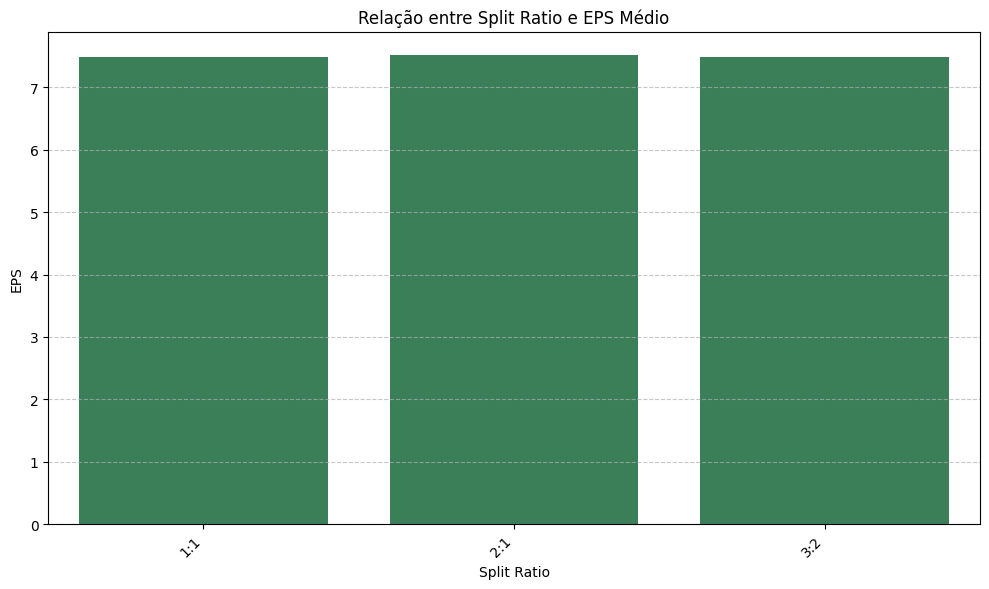

In [92]:
grouped_data = base_final.groupby('Split Ratio')['EPS'].mean().reset_index()

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
sns.barplot(x='Split Ratio', y='EPS', data=grouped_data, color='seagreen')
plt.title('Relação entre Split Ratio e EPS Médio')
plt.xlabel('Split Ratio')
plt.ylabel('EPS')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

O EPS é praticamente igual em todas as colunas, mostrando que ele não é afetado pelas proporções do split

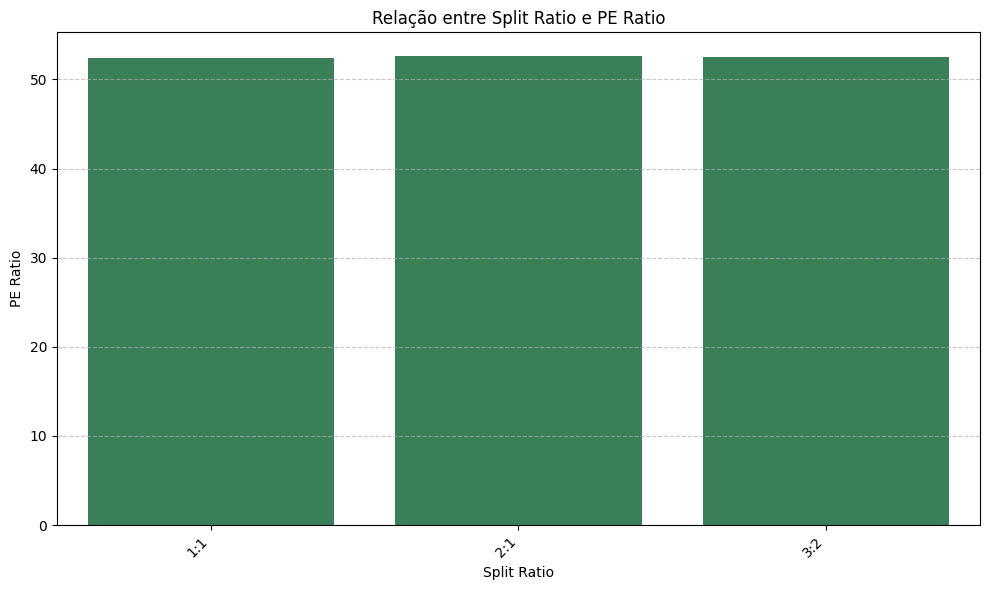

In [93]:
grouped_data = base_final.groupby('Split Ratio')['PE Ratio'].mean().reset_index()

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
sns.barplot(x='Split Ratio', y='PE Ratio', data=grouped_data, color='seagreen')
plt.title('Relação entre Split Ratio e PE Ratio')
plt.xlabel('Split Ratio')
plt.ylabel('PE Ratio')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

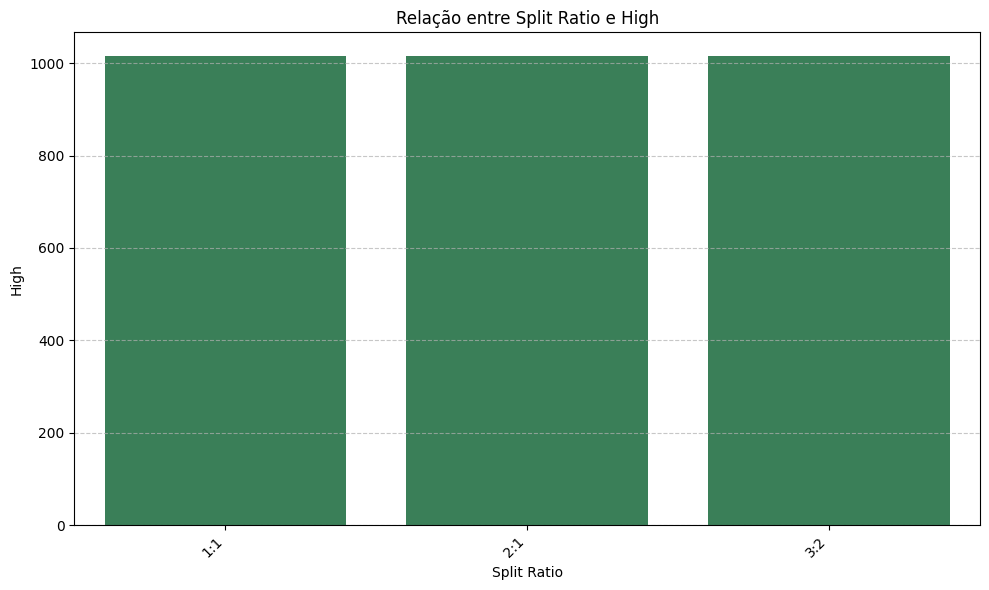

In [94]:
grouped_data = df.groupby('Split Ratio')['High'].mean().reset_index()

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
sns.barplot(x='Split Ratio', y='High', data=grouped_data, color='seagreen')
plt.title('Relação entre Split Ratio e High')
plt.xlabel('Split Ratio')
plt.ylabel('High')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

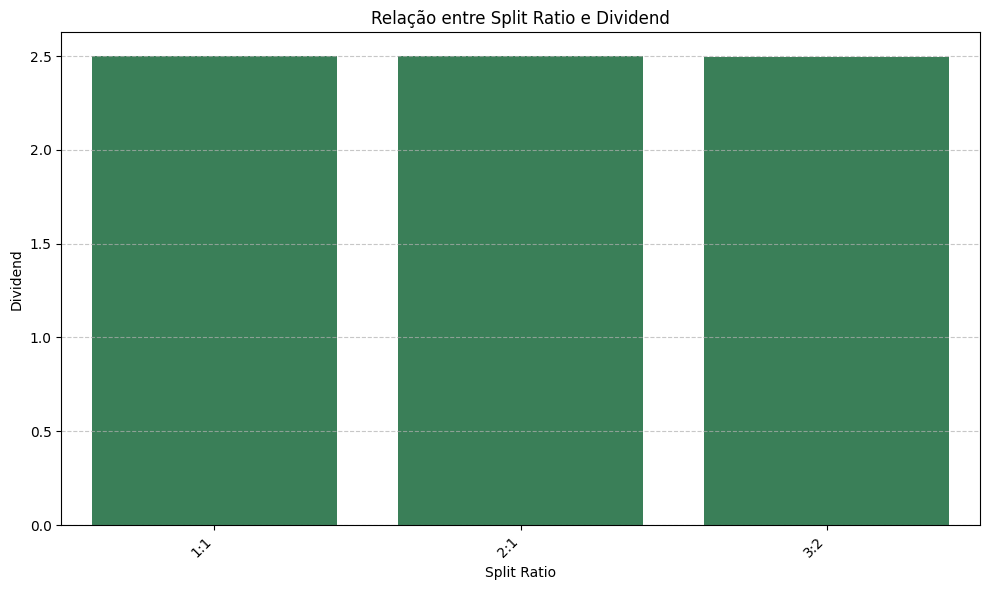

In [95]:
grouped_data = df.groupby('Split Ratio')['Dividend'].mean().reset_index()

# Criando o gráfico de barras
plt.figure(figsize=(10, 6))
sns.barplot(x='Split Ratio', y='Dividend', data=grouped_data, color='seagreen')
plt.title('Relação entre Split Ratio e Dividend')
plt.xlabel('Split Ratio')
plt.ylabel('Dividend')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

plt.show()

Pelos gráficos, é facil perceber que as métricas de desempenho se comportam quase de forma idêntica em todas as proporções de split ratio. Isso demonstra que essas divisões não alteram ou agregam valor para a empresa, apenas tornam as suas ações mais acessíveis ao público geral

Agora vamos gerar gráficos sazonais para ver se é possível perceber alguma tendência de crescimento ou redução nesses valores

In [96]:
# Converter a coluna de data e extrair o ano
base_final['Date'] = pd.to_datetime(df['Date'], errors='coerce')
base_final['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
base_final.dropna(subset=['Date', 'EPS', 'Split Ratio'], inplace=True)

# Calcular a mediana anual do EPS por Split Ratio
# Agrupar por Ano e Split Ratio e calcular a mediana do EPS
eps_anual_por_SP = df.groupby(['Ano', 'Split Ratio'])['EPS'].median().reset_index()

# Visualização para Split Ratio
SP_para_visualizar = eps_anual_por_SP['Split Ratio'].unique()[:3]

# Filtrar dados para as Split Ratio selecionadas
eps_vis = eps_anual_por_SP[eps_anual_por_SP['Split Ratio'].isin(SP_para_visualizar)]

if not eps_vis.empty:
    fig = px.line(
        eps_vis,
        x='Ano',
        y='EPS',
        color='Split Ratio',
        title='Mediana Anual do EPS por Split Ratio',
        labels={'EPS': 'Mediana do EPS', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Mediana do EPS', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes para visualizar nos split ratios selecionados.")

Assim como nos gráficos de barra, aqui a variação não demonstra nenhuma tendência que pode ser seguida, com valores muito próximos e todos em constante variação ao longo dos anos

In [97]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'Dividend', 'Split Ratio'], inplace=True)

# Calcular a mediana anual do Dividend por Split Ratio
# Agrupar por Ano e Split Ratio e calcular a mediana do Dividend
dividend_anual_por_SP = df.groupby(['Ano', 'Split Ratio'])['Dividend'].median().reset_index()

# Visualização para Split Ratio
SP_para_visualizar = dividend_anual_por_SP['Split Ratio'].unique()[:3]

# Filtrar dados para os Split Ratios selecionados
dividend_vis = dividend_anual_por_SP[dividend_anual_por_SP['Split Ratio'].isin(SP_para_visualizar)]

if not dividend_vis.empty:
    fig = px.line(
        dividend_vis,
        x='Ano',
        y='Dividend',
        color='Split Ratio',
        title='Mediana Anual do Dividend por Split Ratio',
        labels={'Dividend': 'Mediana do Dividend', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Mediana do Dividend', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes para visualizar nos Split Ratios selecionados.")

In [98]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'High', 'Split Ratio'], inplace=True)

# Calcular a mediana anual do High por Split Ratio
# Agrupar por Ano e Split Ratio e calcular a mediana do High
high_anual_por_SP = df.groupby(['Ano', 'Split Ratio'])['High'].median().reset_index()

# Visualização para Split Ratio
SP_para_visualizar = high_anual_por_SP['Split Ratio'].unique()[:3]

# Filtrar dados para os Split Ratios selecionados
high_vis = high_anual_por_SP[high_anual_por_SP['Split Ratio'].isin(SP_para_visualizar)]

if not high_vis.empty:
    fig = px.line(
        high_vis,
        x='Ano',
        y='High',
        color='Split Ratio',
        title='Mediana Anual do High por Split Ratio',
        labels={'High': 'Mediana do High', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Mediana do High', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes para visualizar nos Split Ratios selecionados.")

Os padrões continuam a se repetir. Valores muito próximos e com constante alternância entre subidas e descidas

In [99]:
# Converter a coluna de data e extrair o ano
df['Date'] = pd.to_datetime(df['Date'], errors='coerce')
df['Ano'] = df['Date'].dt.year

# Remover linhas com datas inválidas após a conversão
df.dropna(subset=['Date', 'PE Ratio', 'Split Ratio'], inplace=True)

# Calcular a mediana anual do PE Ratio por Split Ratio
# Agrupar por Ano e Split Ratio e calcular a mediana do PE Ratio
PERatio_anual_por_SP = df.groupby(['Ano', 'Split Ratio'])['PE Ratio'].median().reset_index()

# Visualização para Split Ratio
SP_para_visualizar = PERatio_anual_por_SP['Split Ratio'].unique()[:3]

# Filtrar dados para os Split Ratios selecionados
PERatio_vis = PERatio_anual_por_SP[PERatio_anual_por_SP['Split Ratio'].isin(SP_para_visualizar)]

if not PERatio_vis.empty:
    fig = px.line(
        PERatio_vis,
        x='Ano',
        y='PE Ratio',
        color='Split Ratio',
        title='Mediana Anual do PE Ratio por Split Ratio',
        labels={'PE Ratio': 'Mediana do PE Ratio', 'Ano': 'Ano'},
        template='plotly_white',
        markers=True
    )

    fig.update_layout(yaxis_title='Mediana do PE Ratio', xaxis_title='Ano')
    fig.show()
else:
    print("\nNão há dados suficientes para visualizar nos Split Ratios selecionados.")

As análise sazonais corroboram a primeira afirmação, pois não é possível verificar alguma tendência para o futuro de algum split ratio que venha performando melhor. É possível observar que para cada métrica, os valores analisados se alternam, concluímos então que não existe alguma proporção de split que seja mais benéfica pensando em ganhos absolutos de alguma empresa

#### **Conclusão Final**

Podemos perceber que definir quais são as empresas apresentaram melhor desempenho depende bastante do objetivo de quem está analisando.

Tendo isso em mente, trouxemos 3 métricas distintas para diferentes público alvos de investidores.

A partir da nossa análise, podemos definir as seguintes empresas com melhores desempenhos:

Para investidores de curto prazo: UBER, SQ, LYFT, ORCL, INTU.

Para investidores que buscam renda passiva: INTC, SHOP, PYPL, SNAP, IBM

Para investidores que traders longos: SHOP, NVDA, TWTR, UBER, WORK.

Com destaque para empresas como UBER e SHOP, que conseguem atingir diferentes público alvos.